# **Data Valorization Project**

- Ilaria Enache 
- Taylor Lucero
- Yasaman Pazhoolideh
- Zeyneb M'Hamedi

**Background**

Ethereum is a decentralized, open-source blockchain with smart contract functionality. Ether (ETH) is the native cryptocurrency of the platform. Among cryptocurrencies, Ether is second only to Bitcoin in market capitalization. Ethereum was proposed in 2013 by programmer Vitalik Buterin.

**Data Description**

This dataset provides the history of daily prices of Ethereum. The data starts from 09-Aug-2015 and ends 07-Jul-2021.

**Loading packages**

In [1]:
oldw <- getOption("warn") #to remove warnings
options(warn = -1)

library(tidyverse) #loads different packages for analysis and visualization
library(ggplot2) #for data visualisation 
library(plotrix) #for plotting
library(Hmisc) #for graphs 

library(lubridate) #for dates/time
library(janitor) #for cleaning data
library(dplyr) #for data manipulation

library(knitr) #for dynamic report generation
library(broom) #for tidying data 
library(DataCombine) #for datasets
library(corrplot) #for correlation 
library(caret) #for Classification And REgression Training
library(car) #Companion to Applied Regression
library(lmtest)
library(leaps)

library(MASS) #for multivariate distributions
library(mvtnorm) #for multivariete normal and t distribution
library(MVN) # for multivariate normality tests

#for our model
library(tibble)
library(tibbletime)
library(fpp2)
library(astsa)
library(plotly)
library(timetk)

library(prophet) #for forecasting

options(warn = oldw)

── Attaching packages ─────────────────────────────────────── tidyverse 1.3.1 ──

✔ ggplot2 3.3.5     ✔ purrr   0.3.4
✔ tibble  3.1.5     ✔ dplyr   1.0.7
✔ tidyr   1.1.4     ✔ stringr 1.4.0
✔ readr   2.0.2     ✔ forcats 0.5.1

── Conflicts ────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::filter() masks stats::filter()
✖ dplyr::lag()    masks stats::lag()

Loading required package: lattice

Loading required package: survival

Loading required package: Formula


Attaching package: ‘Hmisc’


The following objects are masked from ‘package:dplyr’:

    src, summarize


The following objects are masked from ‘package:base’:

    format.pval, units



Attaching package: ‘lubridate’


The following objects are masked from ‘package:base’:

    date, intersect, setdiff, union



Attaching package: ‘janitor’


The following objects are masked from ‘package:stats’:

    chisq.test, fisher.test


corrplot 0.88 loaded


Attaching package: ‘caret’


The following object is 

**Importing and Pre-Processing**
Removing NA values - 
Scaling 
Normalization or Standardization or Regularization 
Factorization - 

In [2]:
#importing the dataset we are going to use
ether = read.csv("../input/cryptocurrencypricehistory/coin_Ethereum.csv")

## Distribution And Data 

With the given measures of central tendency and  the 1st\3rd Quartile, we can numerically understand the distribution of data. This is important for when the Features are visualized we will be able to add value and conceptual understanding of the sample for the Ethereum bitcoin.

SNo - Serial Number: the Unique identifier of the Ethereum dataset.<br>
Datatype: Integer (Unqiue identifier for each instance)

Name : the Name of the coin <br>
Datatype: String 

Symbol - the Symbol or Acronym associated with the Ethereum Coin<br>
Datatype: String 

Date : Time and Date of when the particular instance was created<br>
Datatype: Data/Time format ( Currently String)

High -  The greatest value of the coin at that time<br>
Datatype: Float 

Low - The lowest value of the coin at that time<br>
Datatype: Float

Open - Opening price on the given day<br>
Datatype: Float

Close- Closing price on the given day<br>
Datatype: Float
 
Volume -  Volume of transactions on the given day<br>
Datatype: Float

Marketcap - Market capitalization in USD or the total value of all the coins that have been mined in USD.<br>
Datatype: Float 

# Data Exploration

1. Mean, Median, Mode
2. Outlier detection
3. Distribution
4. Data Types 
5. Explanation of Features 
6. Visualization 


In [3]:
#mean, median and some other stats
summary(ether)

      SNo             Name              Symbol              Date          
 Min.   :   1.0   Length:2160        Length:2160        Length:2160       
 1st Qu.: 540.8   Class :character   Class :character   Class :character  
 Median :1080.5   Mode  :character   Mode  :character   Mode  :character  
 Mean   :1080.5                                                           
 3rd Qu.:1620.2                                                           
 Max.   :2160.0                                                           
      High               Low                Open              Close         
 Min.   :   0.483   Min.   :   0.421   Min.   :   0.432   Min.   :   0.435  
 1st Qu.:  14.265   1st Qu.:  13.191   1st Qu.:  13.758   1st Qu.:  13.819  
 Median : 205.125   Median : 193.303   Median : 198.425   Median : 198.644  
 Mean   : 398.259   Mean   : 365.593   Mean   : 382.880   Mean   : 383.911  
 3rd Qu.: 396.495   3rd Qu.: 375.147   3rd Qu.: 386.265   3rd Qu.: 386.435  
 Max.   :4362

We are normalizing the data using minmax function: for every feature, the minimum value of that feature gets transformed into a 0, the maximum value gets transformed into a 1, and every other value gets transformed into a decimal between 0 and 1.

In [4]:
min_max_norm <- function(x) {
    (x - min(x)) / (max(x) - min(x))
  }

ether_norm <- as.data.frame(lapply(ether[5:10], min_max_norm))
num_val <- ether_norm
head(ether_norm)
tail(ether_norm)

,High,Low,Open,Close,Volume,Marketcap
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,5.309244e-04,7.762082e-05,5.658973e-04,7.640970e-05,6.771318e-06,2.748944e-05
2,9.097525e-05,5.502522e-05,6.577229e-05,6.407173e-05,5.090290e-06,2.109548e-05
3,5.659640e-05,5.696820e-05,6.765362e-05,6.564336e-05,3.588363e-06,2.196281e-05
4,1.486570e-04,6.401866e-05,6.623970e-05,1.518691e-04,1.610945e-05,6.700980e-05
5,1.850015e-04,1.222348e-04,1.502468e-04,1.877546e-04,2.424744e-05,8.580597e-05
6,3.397815e-04,1.984170e-04,1.894136e-04,3.341536e-04,4.695099e-05,1.623560e-04


,High,Low,Open,Close,Volume,Marketcap
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
2155,0.5213167,0.5496499,0.5447663,0.5069663,0.3439942,0.5099848
2156,0.4940805,0.5339962,0.5053565,0.5157074,0.3763619,0.5188375
2157,0.5128730,0.5592946,0.5151649,0.5339581,0.2063527,0.5372590
2158,0.5465099,0.5786445,0.5333037,0.5568956,0.2223767,0.5604010
2159,0.5322124,0.5713015,0.5561518,0.5273530,0.2379619,0.5307358
2160,0.5377999,0.5805152,0.5264447,0.5576046,0.2472901,0.5612438


## Pre-filtering Feature Distibutions


**High Prices Distribution**

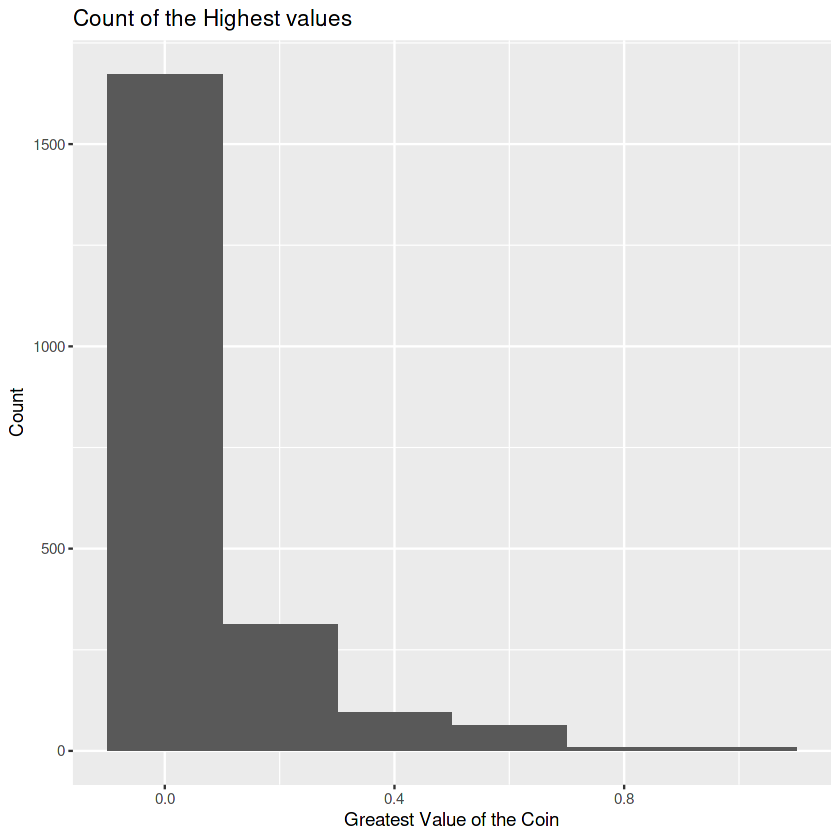

In [5]:
ggplot(ether_norm, aes(x=High)) +
  geom_histogram(bins=1 ,binwidth =0.20) +
  ggtitle("Count of the Highest values") +
  labs(y= "Count", x = "Greatest Value of the Coin")

**Low Prices Distribution**

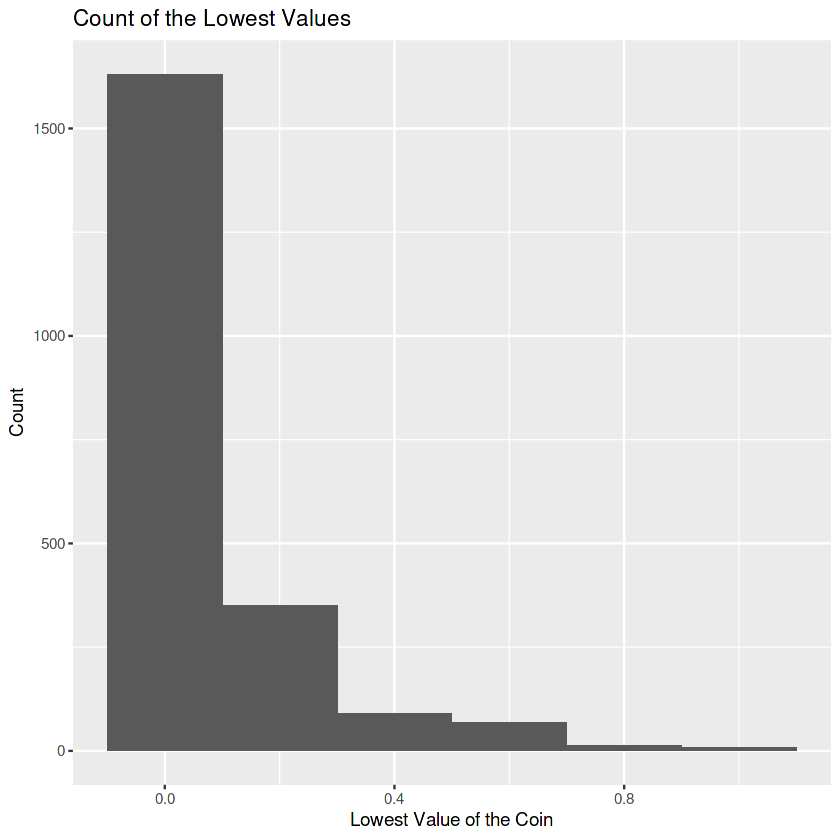

In [6]:
ggplot(ether_norm, aes(x=Low)) +
  geom_histogram(bins=1 ,binwidth =.20) +
  ggtitle("Count of the Lowest Values") +
  labs(y= "Count", x = "Lowest Value of the Coin")

**Open Prices Distribution**

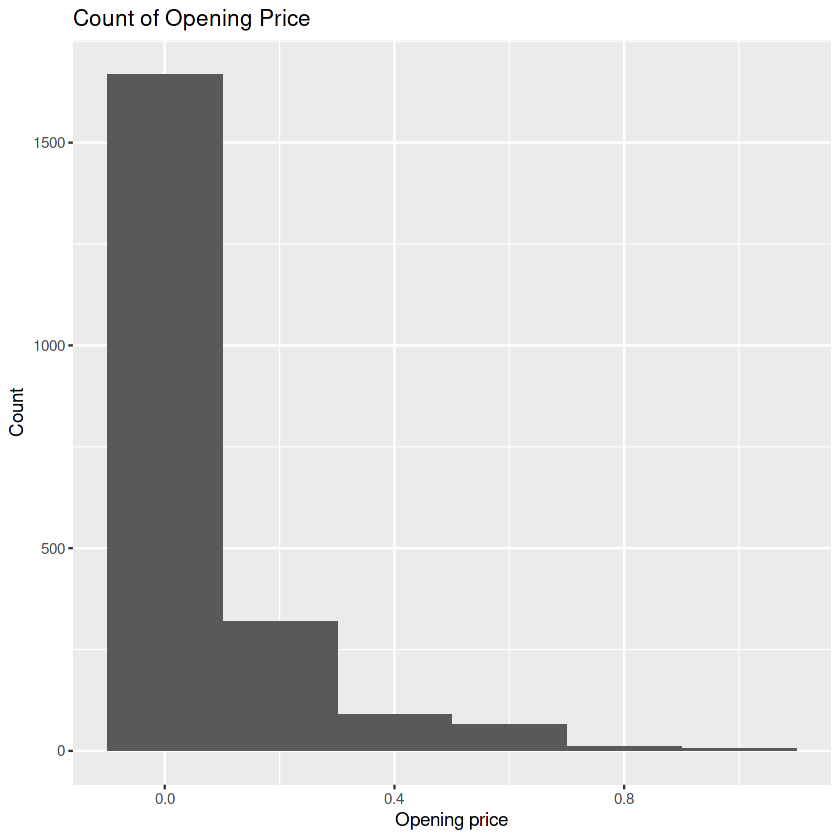

In [7]:
ggplot(ether_norm, aes(x=Open)) +
  geom_histogram(bins=1 ,binwidth =.20) +
  ggtitle("Count of Opening Price") +
  labs(y= "Count", x = "Opening price")

**Close Prices Distribution**

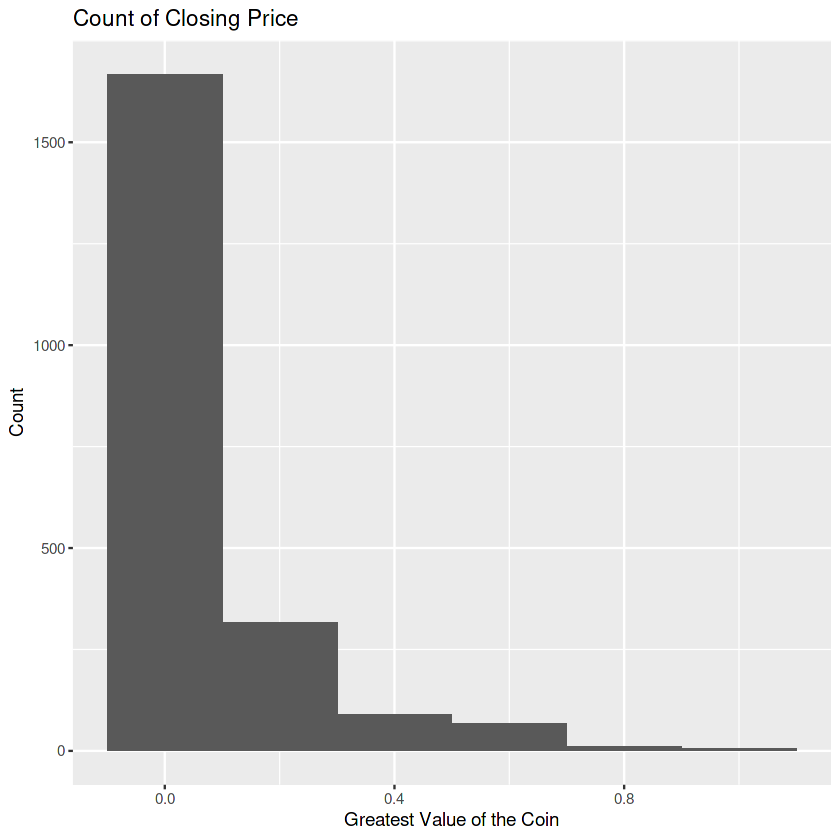

In [8]:
ggplot(ether_norm, aes(x=Close)) +
  geom_histogram(bins=1 ,binwidth =.20) +
  ggtitle("Count of Closing Price") +
  labs(y= "Count", x = "Greatest Value of the Coin")

**Volume Distribution**

In [9]:
#table(ether_norm$Volume)

#Min.   :1.021e+05   Min.   :3.221e+07  
 #1st Qu.:3.825e+07   1st Qu.:1.136e+09  
 #Median :2.149e+09   Median :2.070e+10  
 #Mean   :7.057e+09   Mean   :4.172e+10  
 #3rd Qu.:9.629e+09   3rd Qu.:4.231e+10  
 #Max.   :8.448e+10   Max.   :4.829e+11 


str(ether_norm)
summary(ether_norm)
#str(Vol_ether)
# calculate group counts:
#table(cut(df$value, breaks=c(0,21,30,Inf)))

'data.frame':	2160 obs. of  6 variables:
 $ High     : num  5.31e-04 9.10e-05 5.66e-05 1.49e-04 1.85e-04 ...
 $ Low      : num  7.76e-05 5.50e-05 5.70e-05 6.40e-05 1.22e-04 ...
 $ Open     : num  5.66e-04 6.58e-05 6.77e-05 6.62e-05 1.50e-04 ...
 $ Close    : num  7.64e-05 6.41e-05 6.56e-05 1.52e-04 1.88e-04 ...
 $ Volume   : num  6.77e-06 5.09e-06 3.59e-06 1.61e-05 2.42e-05 ...
 $ Marketcap: num  2.75e-05 2.11e-05 2.20e-05 6.70e-05 8.58e-05 ...


      High              Low                Open              Close         
 Min.   :0.00000   Min.   :0.000000   Min.   :0.000000   Min.   :0.000000  
 1st Qu.:0.00316   1st Qu.:0.003374   1st Qu.:0.003193   1st Qu.:0.003211  
 Median :0.04692   Median :0.050954   Median :0.047433   Median :0.047552  
 Mean   :0.09119   Mean   :0.096468   Mean   :0.091622   Mean   :0.091999  
 3rd Qu.:0.09079   3rd Qu.:0.098992   3rd Qu.:0.092433   3rd Qu.:0.092605  
 Max.   :1.00000   Max.   :1.000000   Max.   :1.000000   Max.   :1.000000  
     Volume            Marketcap       
 Min.   :0.0000000   Min.   :0.000000  
 1st Qu.:0.0004516   1st Qu.:0.002285  
 Median :0.0254345   Median :0.042805  
 Mean   :0.0835313   Mean   :0.086339  
 3rd Qu.:0.1139762   3rd Qu.:0.087559  
 Max.   :1.0000000   Max.   :1.000000  

In [10]:
# Bin the Volume Data

Vol_ether <- ether_norm$Volume
# get categories
group_volume <- cut(Vol_ether, breaks=c(0,0.0004 ,0.02, 0.08 ,.1, 1))
group_volume<-data.frame(name=c("0", "0.0004", "0.02", "0.08", ".1", "1"), value=Vol_ether)

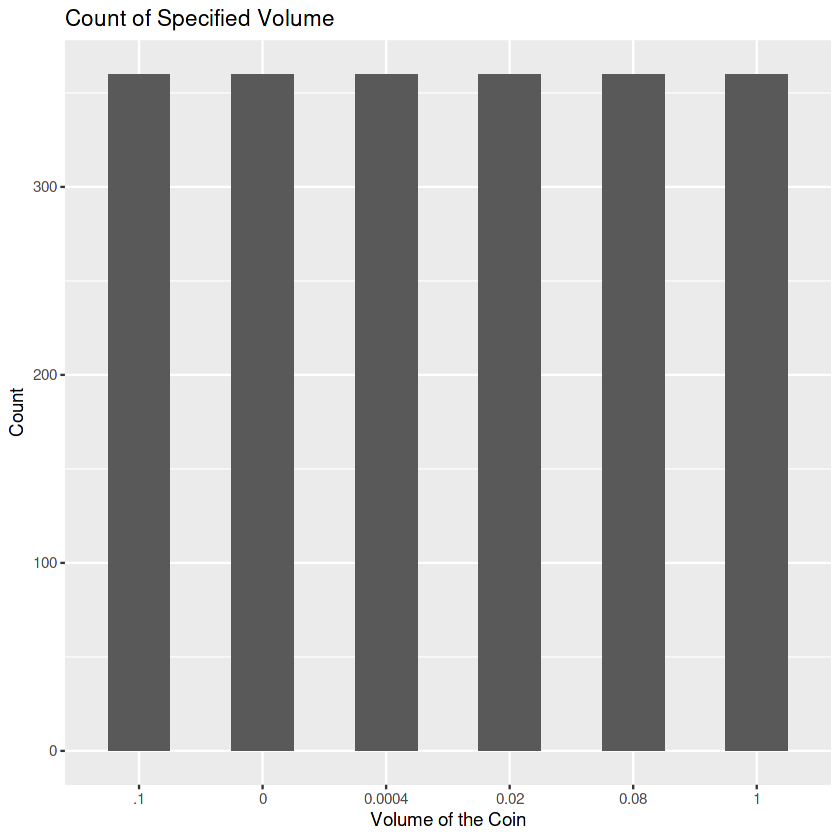

In [11]:
ggplot(group_volume, aes(x=name)) +
  stat_count(width = 0.5) +
  ggtitle("Count of Specified Volume") +
  labs(y= "Count", x = "Volume of the Coin")

**Marketcap Distribution**

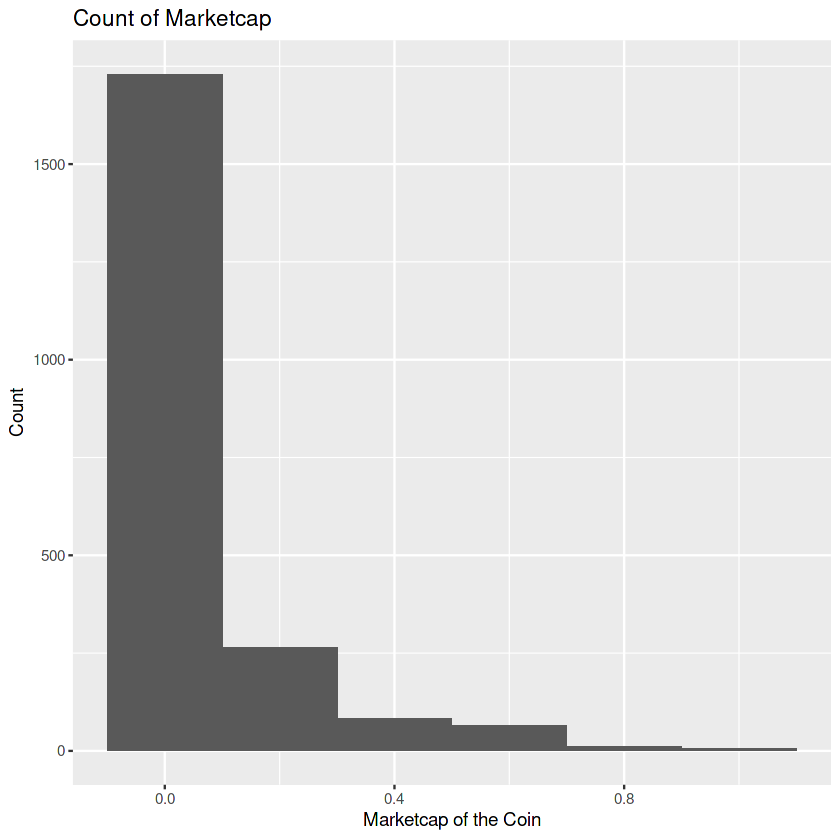

In [12]:
ggplot(ether_norm, aes(x=Marketcap)) +
  geom_histogram(bins=1 ,binwidth =.20)+ #stat_count(width = .000009) +
  ggtitle("Count of Marketcap ") +
  labs(y= "Count", x = "Marketcap of the Coin")

**Multivariate Distribution** 
1. Covariate matrix  as sigma
2. Univaraite and multivairate tests 
3. testin multivariate normality

In [13]:
#resizes all plots
options(repr.plot.width = 12, repr.plot.height = 7)

In [14]:
cov <- cov(ether_norm)
cov

,High,Low,Open,Close,Volume,Marketcap
High,0.02073424,0.02149018,0.02066450,0.02073240,0.01406581,0.02053816
Low,0.02149018,0.02240479,0.02144182,0.02155346,0.01435639,0.02135163
Open,0.02066450,0.02144182,0.02064189,0.02065022,0.01396852,0.02045722
Close,0.02073240,0.02155346,0.02065022,0.02079466,0.01397665,0.02060033
Volume,0.01406581,0.01435639,0.01396852,0.01397665,0.01587727,0.01416120
Marketcap,0.02053816,0.02135163,0.02045722,0.02060033,0.01416120,0.02047527


In [15]:
Mnorm<-mvrnorm(n = 2160, rep(0,6), cov)
Mnorm<-as.data.frame(Mnorm)

#Mnorm

str(Mnorm)
#ggplot(Mnorm, aes(x=High, Low, Open, Close, Volume, Marketcap, y = ether_norm$Volume))+
  #geom_point(alpha = .5) +
  #geom_density_2d(inherit.aes = TRUE)+
  #theme_bw()

'data.frame':	2160 obs. of  6 variables:
 $ High     : num  0.1267 0.1205 -0.0492 -0.0505 -0.2692 ...
 $ Low      : num  0.1445 0.1297 -0.0543 -0.0644 -0.2945 ...
 $ Open     : num  0.1316 0.1132 -0.0496 -0.0536 -0.2708 ...
 $ Close    : num  0.1288 0.1285 -0.0454 -0.0572 -0.2731 ...
 $ Volume   : num  0.111 -0.0133 -0.0164 -0.0237 0.0233 ...
 $ Marketcap: num  0.1298 0.1106 -0.0463 -0.0565 -0.2621 ...


$multivariateNormality
         Test Statistic p value MVN
1 E-statistic  1.299649   0.231 YES

$univariateNormality
          Test  Variable Statistic   p value Normality
1 Shapiro-Wilk   High       0.9987    0.1174    YES   
2 Shapiro-Wilk    Low       0.9987    0.0945    YES   
3 Shapiro-Wilk   Open       0.9988    0.1316    YES   
4 Shapiro-Wilk   Close      0.9987    0.1068    YES   
5 Shapiro-Wilk  Volume      0.9987    0.1064    YES   
6 Shapiro-Wilk Marketcap    0.9987    0.1145    YES   

$Descriptives
             n        Mean   Std.Dev       Median        Min       Max
High      2160 0.001598464 0.1436002 3.715243e-03 -0.4766261 0.4313659
Low       2160 0.001237239 0.1491930 4.114505e-03 -0.4928566 0.4588544
Open      2160 0.001753956 0.1433651 5.480152e-03 -0.4799170 0.4343736
Close     2160 0.001143364 0.1437219 4.799415e-03 -0.4790193 0.4383125
Volume    2160 0.002565284 0.1279011 2.765995e-05 -0.3848988 0.3709694
Marketcap 2160 0.001074850 0.1428254 2.866923e-03 -0.4855385 0.4314806
                 25th       75th        Skew    Kurtosis
High      -0.09600668 0.09755344 -0.08072484 -0.15151326
Low       -0.09849425 0.10141555 -0.09456000 -0.14916673
Open      -0.09472206 0.09891431 -0.08185196 -0.14966733
Close     -0.09592503 0.09756535 -0.08896119 -0.14627251
Volume    -0.08486716 0.08376326  0.03410163 -0.09233369
Marketcap -0.09442770 0.09929758 -0.09184137 -0.14020410

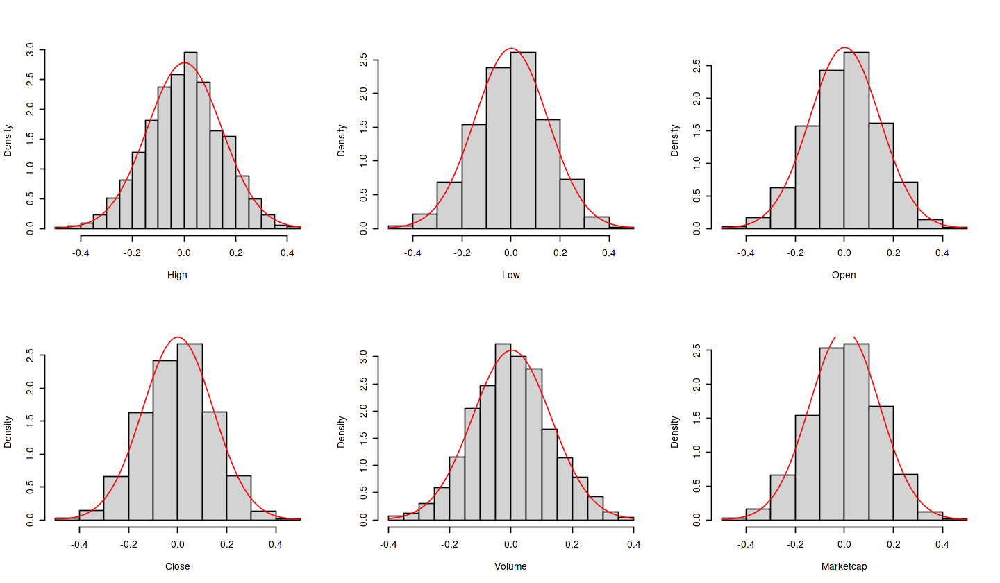

In [16]:
mvn(Mnorm, mvnTest = "energy", univariatePlot = "histogram")

In [17]:
mvn(Mnorm, mvnTest = "energy", univariatePlot = "qq")

$multivariateNormality
         Test Statistic p value MVN
1 E-statistic  1.299649   0.229 YES

$univariateNormality
          Test  Variable Statistic   p value Normality
1 Shapiro-Wilk   High       0.9987    0.1174    YES   
2 Shapiro-Wilk    Low       0.9987    0.0945    YES   
3 Shapiro-Wilk   Open       0.9988    0.1316    YES   
4 Shapiro-Wilk   Close      0.9987    0.1068    YES   
5 Shapiro-Wilk  Volume      0.9987    0.1064    YES   
6 Shapiro-Wilk Marketcap    0.9987    0.1145    YES   

$Descriptives
             n        Mean   Std.Dev       Median        Min       Max
High      2160 0.001598464 0.1436002 3.715243e-03 -0.4766261 0.4313659
Low       2160 0.001237239 0.1491930 4.114505e-03 -0.4928566 0.4588544
Open      2160 0.001753956 0.1433651 5.480152e-03 -0.4799170 0.4343736
Close     2160 0.001143364 0.1437219 4.799415e-03 -0.4790193 0.4383125
Volume    2160 0.002565284 0.1279011 2.765995e-05 -0.3848988 0.3709694
Marketcap 2160 0.001074850 0.1428254 2.866923e-03 -0.4855385 0.4314806
                 25th       75th        Skew    Kurtosis
High      -0.09600668 0.09755344 -0.08072484 -0.15151326
Low       -0.09849425 0.10141555 -0.09456000 -0.14916673
Open      -0.09472206 0.09891431 -0.08185196 -0.14966733
Close     -0.09592503 0.09756535 -0.08896119 -0.14627251
Volume    -0.08486716 0.08376326  0.03410163 -0.09233369
Marketcap -0.09442770 0.09929758 -0.09184137 -0.14020410

Warning message in uniPlot(data, type = univariatePlot):
“Box-Plots are based on standardized values (centered and scaled).”


$multivariateNormality
         Test Statistic p value MVN
1 E-statistic  1.299649   0.222 YES

$univariateNormality
          Test  Variable Statistic   p value Normality
1 Shapiro-Wilk   High       0.9987    0.1174    YES   
2 Shapiro-Wilk    Low       0.9987    0.0945    YES   
3 Shapiro-Wilk   Open       0.9988    0.1316    YES   
4 Shapiro-Wilk   Close      0.9987    0.1068    YES   
5 Shapiro-Wilk  Volume      0.9987    0.1064    YES   
6 Shapiro-Wilk Marketcap    0.9987    0.1145    YES   

$Descriptives
             n        Mean   Std.Dev       Median        Min       Max
High      2160 0.001598464 0.1436002 3.715243e-03 -0.4766261 0.4313659
Low       2160 0.001237239 0.1491930 4.114505e-03 -0.4928566 0.4588544
Open      2160 0.001753956 0.1433651 5.480152e-03 -0.4799170 0.4343736
Close     2160 0.001143364 0.1437219 4.799415e-03 -0.4790193 0.4383125
Volume    2160 0.002565284 0.1279011 2.765995e-05 -0.3848988 0.3709694
Marketcap 2160 0.001074850 0.1428254 2.866923e-03 -0.4855385 0.4314806
                 25th       75th        Skew    Kurtosis
High      -0.09600668 0.09755344 -0.08072484 -0.15151326
Low       -0.09849425 0.10141555 -0.09456000 -0.14916673
Open      -0.09472206 0.09891431 -0.08185196 -0.14966733
Close     -0.09592503 0.09756535 -0.08896119 -0.14627251
Volume    -0.08486716 0.08376326  0.03410163 -0.09233369
Marketcap -0.09442770 0.09929758 -0.09184137 -0.14020410

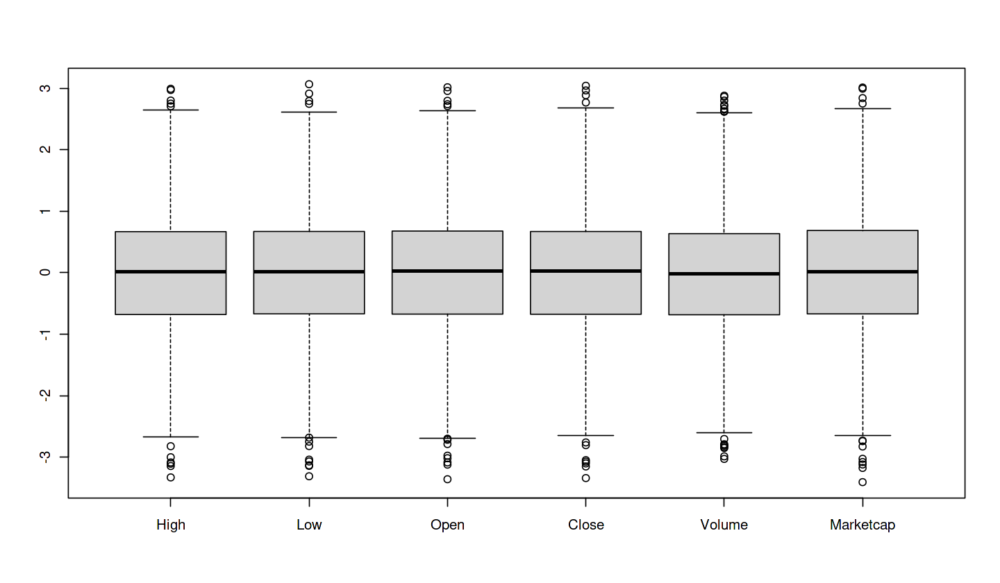

In [18]:
mvn(Mnorm, mvnTest = "energy", univariatePlot = "box")

$multivariateNormality
         Test Statistic p value MVN
1 E-statistic  1.299649   0.192 YES

$univariateNormality
          Test  Variable Statistic   p value Normality
1 Shapiro-Wilk   High       0.9987    0.1174    YES   
2 Shapiro-Wilk    Low       0.9987    0.0945    YES   
3 Shapiro-Wilk   Open       0.9988    0.1316    YES   
4 Shapiro-Wilk   Close      0.9987    0.1068    YES   
5 Shapiro-Wilk  Volume      0.9987    0.1064    YES   
6 Shapiro-Wilk Marketcap    0.9987    0.1145    YES   

$Descriptives
             n        Mean   Std.Dev       Median        Min       Max
High      2160 0.001598464 0.1436002 3.715243e-03 -0.4766261 0.4313659
Low       2160 0.001237239 0.1491930 4.114505e-03 -0.4928566 0.4588544
Open      2160 0.001753956 0.1433651 5.480152e-03 -0.4799170 0.4343736
Close     2160 0.001143364 0.1437219 4.799415e-03 -0.4790193 0.4383125
Volume    2160 0.002565284 0.1279011 2.765995e-05 -0.3848988 0.3709694
Marketcap 2160 0.001074850 0.1428254 2.866923e-03 -0.4855385 0.4314806
                 25th       75th        Skew    Kurtosis
High      -0.09600668 0.09755344 -0.08072484 -0.15151326
Low       -0.09849425 0.10141555 -0.09456000 -0.14916673
Open      -0.09472206 0.09891431 -0.08185196 -0.14966733
Close     -0.09592503 0.09756535 -0.08896119 -0.14627251
Volume    -0.08486716 0.08376326  0.03410163 -0.09233369
Marketcap -0.09442770 0.09929758 -0.09184137 -0.14020410

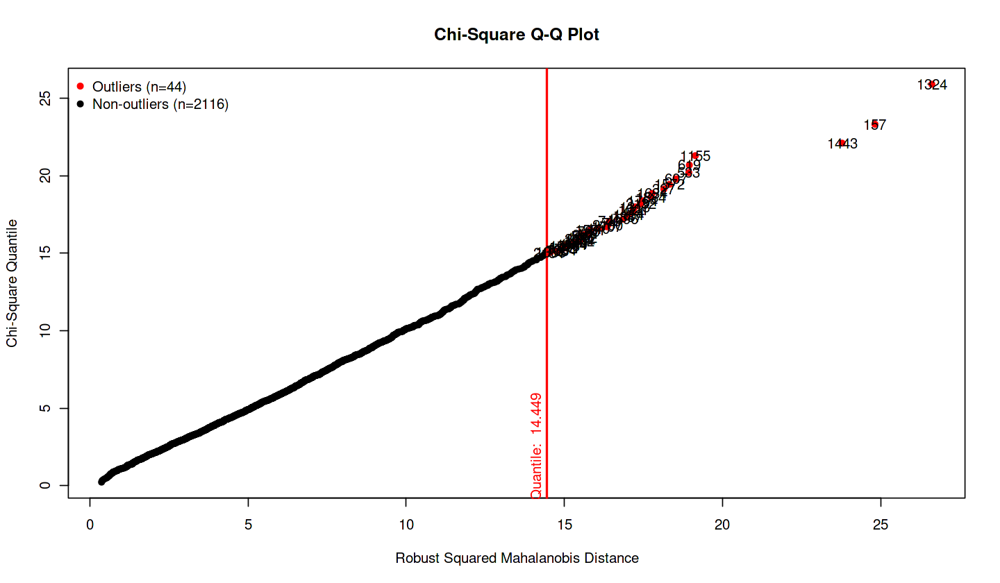

In [19]:
mvn(Mnorm, mvnTest = "energy", multivariatePlot = "scatter", 
    multivariateOutlierMethod="quan")

In [20]:
str(ether_norm)

'data.frame':	2160 obs. of  6 variables:
 $ High     : num  5.31e-04 9.10e-05 5.66e-05 1.49e-04 1.85e-04 ...
 $ Low      : num  7.76e-05 5.50e-05 5.70e-05 6.40e-05 1.22e-04 ...
 $ Open     : num  5.66e-04 6.58e-05 6.77e-05 6.62e-05 1.50e-04 ...
 $ Close    : num  7.64e-05 6.41e-05 6.56e-05 1.52e-04 1.88e-04 ...
 $ Volume   : num  6.77e-06 5.09e-06 3.59e-06 1.61e-05 2.42e-05 ...
 $ Marketcap: num  2.75e-05 2.11e-05 2.20e-05 6.70e-05 8.58e-05 ...


,High,Low,Open,Close,Volume,Marketcap
High,1.0000000,0.9281891,0.9466572,0.9522706,0.2497214,0.8947064
Low,0.9281891,1.0000000,0.9429575,0.9478031,0.2383958,0.9099302
Open,0.9466572,0.9429575,1.0000000,0.9194813,0.2431668,0.8823541
Close,0.9522706,0.9478031,0.9194813,1.0000000,0.2453015,0.9226737
Volume,0.2497214,0.2383958,0.2431668,0.2453015,1.0000000,0.2594075
Marketcap,0.8947064,0.9099302,0.8823541,0.9226737,0.2594075,1.0000000


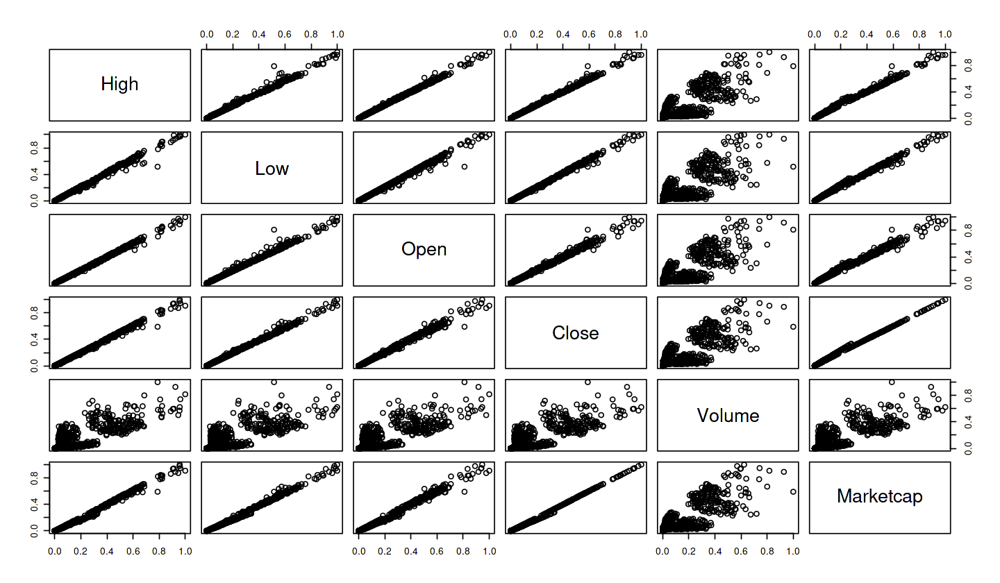

In [21]:
plot(ether_norm)
hoeffd(apply(ether_norm,2, as.numeric))$D

## Correlation matrix

               High       Low      Open     Close    Volume Marketcap
High      1.0000000 0.9970698 0.9988632 0.9984573 0.7752340 0.9967876
Low       0.9970698 1.0000000 0.9970488 0.9985516 0.7611793 0.9968869
Open      0.9988632 0.9970488 1.0000000 0.9967218 0.7715921 0.9950781
Close     0.9984573 0.9985516 0.9967218 1.0000000 0.7691999 0.9983515
Volume    0.7752340 0.7611793 0.7715921 0.7691999 1.0000000 0.7854115
Marketcap 0.9967876 0.9968869 0.9950781 0.9983515 0.7854115 1.0000000


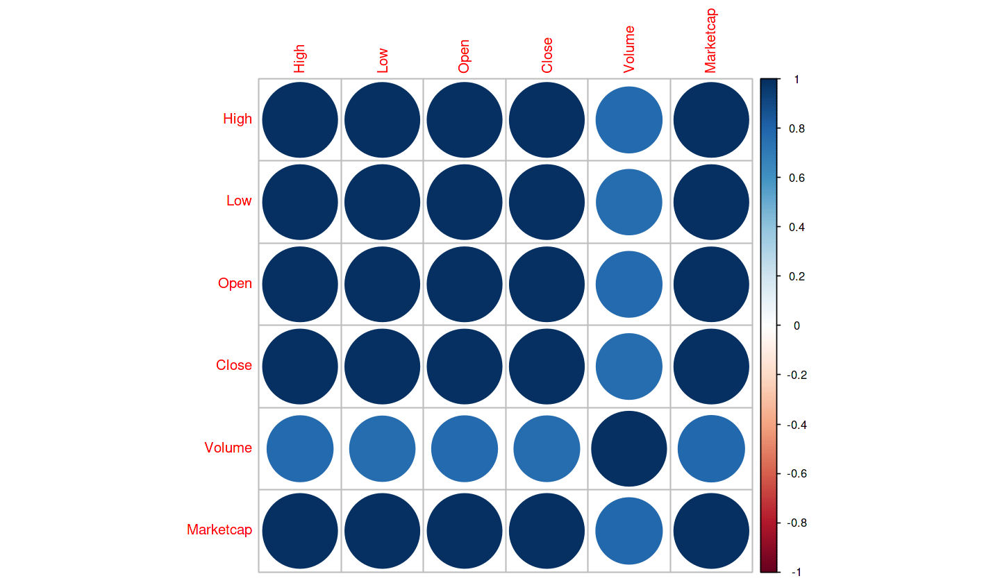

In [22]:
Correlation = cor(ether_norm[, c('High','Low','Open','Close','Volume','Marketcap')])
print(Correlation)
corrplot(Correlation, method="circle")

In [23]:
# Merge the Non numerical features into the normalized dataset 
ether_norm["SNo"] = ether["SNo"]
ether_norm["Symbol"]= ether["Symbol"]
ether_norm["Date"] = ether["Date"]

          
ether_norm <- ether_norm %>% relocate(SNo, .before = High)
ether_norm <- ether_norm %>% relocate(Symbol, .after = SNo)
ether_norm <- ether_norm %>% relocate(Date, .after = Symbol)

head(ether_norm)


,SNo,Symbol,Date,High,Low,Open,Close,Volume,Marketcap
,<int>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,1,ETH,2015-08-08 23:59:59,5.309244e-04,7.762082e-05,5.658973e-04,7.640970e-05,6.771318e-06,2.748944e-05
2,2,ETH,2015-08-09 23:59:59,9.097525e-05,5.502522e-05,6.577229e-05,6.407173e-05,5.090290e-06,2.109548e-05
3,3,ETH,2015-08-10 23:59:59,5.659640e-05,5.696820e-05,6.765362e-05,6.564336e-05,3.588363e-06,2.196281e-05
4,4,ETH,2015-08-11 23:59:59,1.486570e-04,6.401866e-05,6.623970e-05,1.518691e-04,1.610945e-05,6.700980e-05
5,5,ETH,2015-08-12 23:59:59,1.850015e-04,1.222348e-04,1.502468e-04,1.877546e-04,2.424744e-05,8.580597e-05
6,6,ETH,2015-08-13 23:59:59,3.397815e-04,1.984170e-04,1.894136e-04,3.341536e-04,4.695099e-05,1.623560e-04


## Cleaning Data

In [24]:
#filtering out any empty rows or columns and removing duplicates
ether_norm <- remove_empty(ether_norm, which = c("rows", "cols"))
get_dupes(ether_norm)
summary(ether_norm)

No variable names specified - using all columns.


No duplicate combinations found of: SNo, Symbol, Date, High, Low, Open, Close, Volume, Marketcap



SNo,Symbol,Date,High,Low,Open,Close,Volume,Marketcap,dupe_count
<int>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>


      SNo            Symbol              Date                High        
 Min.   :   1.0   Length:2160        Length:2160        Min.   :0.00000  
 1st Qu.: 540.8   Class :character   Class :character   1st Qu.:0.00316  
 Median :1080.5   Mode  :character   Mode  :character   Median :0.04692  
 Mean   :1080.5                                         Mean   :0.09119  
 3rd Qu.:1620.2                                         3rd Qu.:0.09079  
 Max.   :2160.0                                         Max.   :1.00000  
      Low                Open              Close              Volume         
 Min.   :0.000000   Min.   :0.000000   Min.   :0.000000   Min.   :0.0000000  
 1st Qu.:0.003374   1st Qu.:0.003193   1st Qu.:0.003211   1st Qu.:0.0004516  
 Median :0.050954   Median :0.047433   Median :0.047552   Median :0.0254345  
 Mean   :0.096468   Mean   :0.091622   Mean   :0.091999   Mean   :0.0835313  
 3rd Qu.:0.098992   3rd Qu.:0.092433   3rd Qu.:0.092605   3rd Qu.:0.1139762  
 Max.   :1.000

In [25]:
#convert date from chr to date format
ether_norm$Date <- as.POSIXct(ether$Date)

#removing NAs
ether_norm = na.omit(ether_norm)

summary(ether_norm)

      SNo            Symbol               Date                    
 Min.   :   1.0   Length:2160        Min.   :2015-08-08 23:59:59  
 1st Qu.: 540.8   Class :character   1st Qu.:2017-01-29 17:59:59  
 Median :1080.5   Mode  :character   Median :2018-07-23 11:59:59  
 Mean   :1080.5                      Mean   :2018-07-23 11:59:59  
 3rd Qu.:1620.2                      3rd Qu.:2020-01-14 05:59:59  
 Max.   :2160.0                      Max.   :2021-07-06 23:59:59  
      High              Low                Open              Close         
 Min.   :0.00000   Min.   :0.000000   Min.   :0.000000   Min.   :0.000000  
 1st Qu.:0.00316   1st Qu.:0.003374   1st Qu.:0.003193   1st Qu.:0.003211  
 Median :0.04692   Median :0.050954   Median :0.047433   Median :0.047552  
 Mean   :0.09119   Mean   :0.096468   Mean   :0.091622   Mean   :0.091999  
 3rd Qu.:0.09079   3rd Qu.:0.098992   3rd Qu.:0.092433   3rd Qu.:0.092605  
 Max.   :1.00000   Max.   :1.000000   Max.   :1.000000   Max.   :1.000000  

## Clustering

In [26]:
str(ether_norm)

'data.frame':	2160 obs. of  9 variables:
 $ SNo      : int  1 2 3 4 5 6 7 8 9 10 ...
 $ Symbol   : chr  "ETH" "ETH" "ETH" "ETH" ...
 $ Date     : POSIXct, format: "2015-08-08 23:59:59" "2015-08-09 23:59:59" ...
 $ High     : num  5.31e-04 9.10e-05 5.66e-05 1.49e-04 1.85e-04 ...
 $ Low      : num  7.76e-05 5.50e-05 5.70e-05 6.40e-05 1.22e-04 ...
 $ Open     : num  5.66e-04 6.58e-05 6.77e-05 6.62e-05 1.50e-04 ...
 $ Close    : num  7.64e-05 6.41e-05 6.56e-05 1.52e-04 1.88e-04 ...
 $ Volume   : num  6.77e-06 5.09e-06 3.59e-06 1.61e-05 2.42e-05 ...
 $ Marketcap: num  2.75e-05 2.11e-05 2.20e-05 6.70e-05 8.58e-05 ...


In [27]:
head(ether_norm)
tail(ether_norm)

,SNo,Symbol,Date,High,Low,Open,Close,Volume,Marketcap
,<int>,<chr>,<dttm>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,1,ETH,2015-08-08 23:59:59,5.309244e-04,7.762082e-05,5.658973e-04,7.640970e-05,6.771318e-06,2.748944e-05
2,2,ETH,2015-08-09 23:59:59,9.097525e-05,5.502522e-05,6.577229e-05,6.407173e-05,5.090290e-06,2.109548e-05
3,3,ETH,2015-08-10 23:59:59,5.659640e-05,5.696820e-05,6.765362e-05,6.564336e-05,3.588363e-06,2.196281e-05
4,4,ETH,2015-08-11 23:59:59,1.486570e-04,6.401866e-05,6.623970e-05,1.518691e-04,1.610945e-05,6.700980e-05
5,5,ETH,2015-08-12 23:59:59,1.850015e-04,1.222348e-04,1.502468e-04,1.877546e-04,2.424744e-05,8.580597e-05
6,6,ETH,2015-08-13 23:59:59,3.397815e-04,1.984170e-04,1.894136e-04,3.341536e-04,4.695099e-05,1.623560e-04


,SNo,Symbol,Date,High,Low,Open,Close,Volume,Marketcap
,<int>,<chr>,<dttm>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
2155,2155,ETH,2021-07-01 23:59:59,0.5213167,0.5496499,0.5447663,0.5069663,0.3439942,0.5099848
2156,2156,ETH,2021-07-02 23:59:59,0.4940805,0.5339962,0.5053565,0.5157074,0.3763619,0.5188375
2157,2157,ETH,2021-07-03 23:59:59,0.5128730,0.5592946,0.5151649,0.5339581,0.2063527,0.5372590
2158,2158,ETH,2021-07-04 23:59:59,0.5465099,0.5786445,0.5333037,0.5568956,0.2223767,0.5604010
2159,2159,ETH,2021-07-05 23:59:59,0.5322124,0.5713015,0.5561518,0.5273530,0.2379619,0.5307358
2160,2160,ETH,2021-07-06 23:59:59,0.5377999,0.5805152,0.5264447,0.5576046,0.2472901,0.5612438


In [28]:
#Dates of highest and lowest points
head(ether_norm[order(-ether_norm$High),])
head(ether_norm[order(ether_norm$Low),])

,SNo,Symbol,Date,High,Low,Open,Close,Volume,Marketcap
,<int>,<chr>,<dttm>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
2105,2105,ETH,2021-05-12 23:59:59,1.0000000,1.0000000,1.0000000,0.9081507,0.8170098,0.9082596
2103,2103,ETH,2021-05-10 23:59:59,0.9622003,0.9732139,0.9400550,0.9480822,0.7420644,0.9479741
2104,2104,ETH,2021-05-11 23:59:59,0.9577837,0.9994825,0.9457708,1.0000000,0.6235545,1.0000000
2107,2107,ETH,2021-05-14 23:59:59,0.9561349,0.9782195,0.8911137,0.9784938,0.5702245,0.9788375
2108,2108,ETH,2021-05-15 23:59:59,0.9465447,0.9609749,0.9763585,0.8727099,0.5021402,0.8731224
2106,2106,ETH,2021-05-13 23:59:59,0.9243932,0.9375391,0.9171776,0.8911892,0.9279771,0.8914018


,SNo,Symbol,Date,High,Low,Open,Close,Volume,Marketcap
,<int>,<chr>,<dttm>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
75,75,ETH,2015-10-21 23:59:59,0.000000e+00,0.000000e+00,0.000000e+00,2.998853e-06,6.000712e-06,1.940975e-06
76,76,ETH,2015-10-22 23:59:59,3.128889e-05,2.483115e-08,3.209954e-06,3.187728e-05,9.738005e-06,2.044439e-05
74,74,ETH,2015-10-20 23:59:59,4.335297e-06,2.840096e-06,1.390444e-05,0.000000e+00,3.335507e-06,0.000000e+00
73,73,ETH,2015-10-19 23:59:59,8.839793e-06,1.587588e-05,2.061039e-05,1.299941e-05,1.676246e-06,8.288289e-06
68,68,ETH,2015-10-14 23:59:59,2.963227e-05,1.666311e-05,4.327795e-05,2.114524e-05,1.029246e-05,1.336189e-05
77,77,ETH,2015-10-23 23:59:59,2.951831e-05,2.202843e-05,3.228903e-05,2.514907e-05,9.193515e-06,1.616802e-05


In [29]:
#most trading by volume by date
head(ether_norm[order(-ether_norm$Volume),])

,SNo,Symbol,Date,High,Low,Open,Close,Volume,Marketcap
,<int>,<chr>,<dttm>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
2112,2112,ETH,2021-05-19 23:59:59,0.7880690,0.5156721,0.8102683,0.5902321,1.0000000,0.5907977
2106,2106,ETH,2021-05-13 23:59:59,0.9243932,0.9375391,0.9171776,0.8911892,0.9279771,0.8914018
2105,2105,ETH,2021-05-12 23:59:59,1.0000000,1.0000000,1.0000000,0.9081507,0.8170098,0.9082596
2113,2113,ETH,2021-05-20 23:59:59,0.6860965,0.5732003,0.5843526,0.6678698,0.8002897,0.6685832
2103,2103,ETH,2021-05-10 23:59:59,0.9622003,0.9732139,0.9400550,0.9480822,0.7420644,0.9479741
2097,2097,ETH,2021-05-04 23:59:59,0.8077051,0.8401486,0.8218812,0.7804671,0.7386348,0.7798393


# Visualizing data

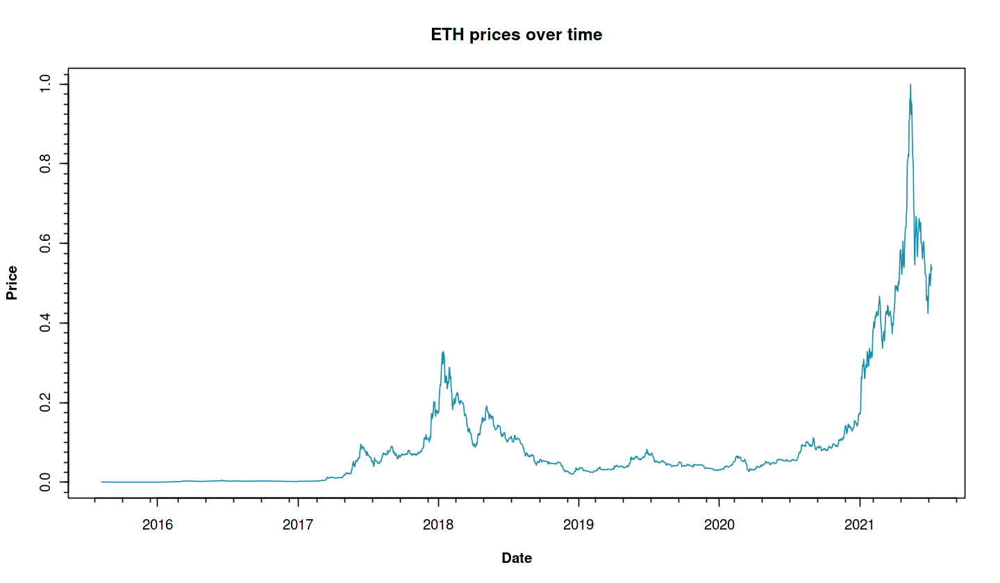

In [30]:
#visualize the price chart
plot(ether_norm$Date, ether_norm$High, 
     type = "l", 
     main = "ETH prices over time", 
     xlab = "Date", ylab = "Price", 
     col = "#158FAD",
     font.lab = 2
    )
minor.tick(nx = 8, ny = 8, tick.ratio = 0.5)

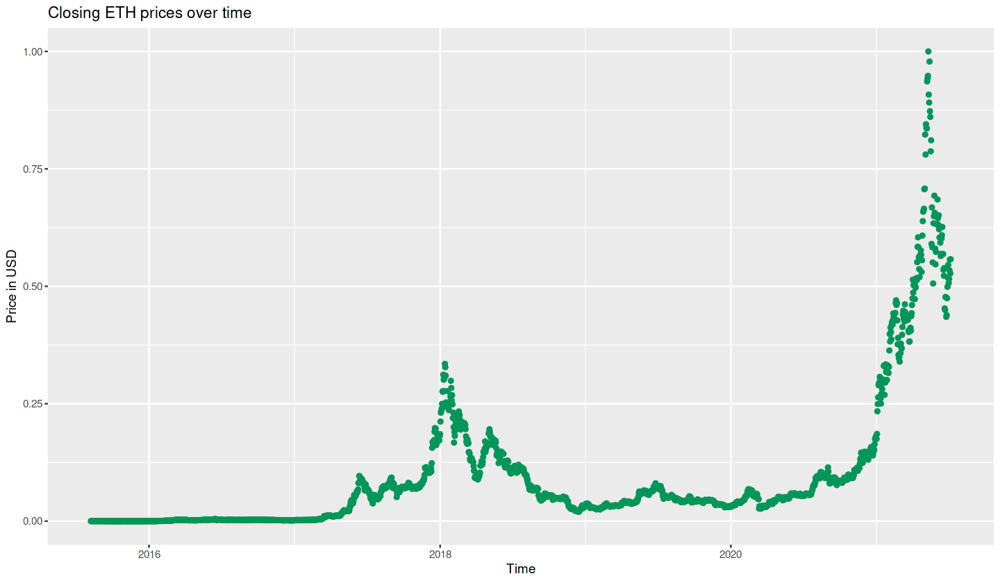

In [31]:
#closing prices over time
ggplot(data = ether_norm, aes(x=as.Date(Date),y=Close)) +
    geom_point(color= "#029658") +
    labs(title="Closing ETH prices over time", y="Price in USD", x="Time")

We add another layer to our ggplot. Viewing lots of scattered points can obscure trends so we are going to use geom_smooth(). 
We will additionally use the smoothing method "gam". 
Smooth() expects continuous variables along the x axis. We can tell it to just connect points between days, and get a line that is technically not mathematically smooth, but good enough for inspection. We are so zoomed out from individual days that it should not matter.

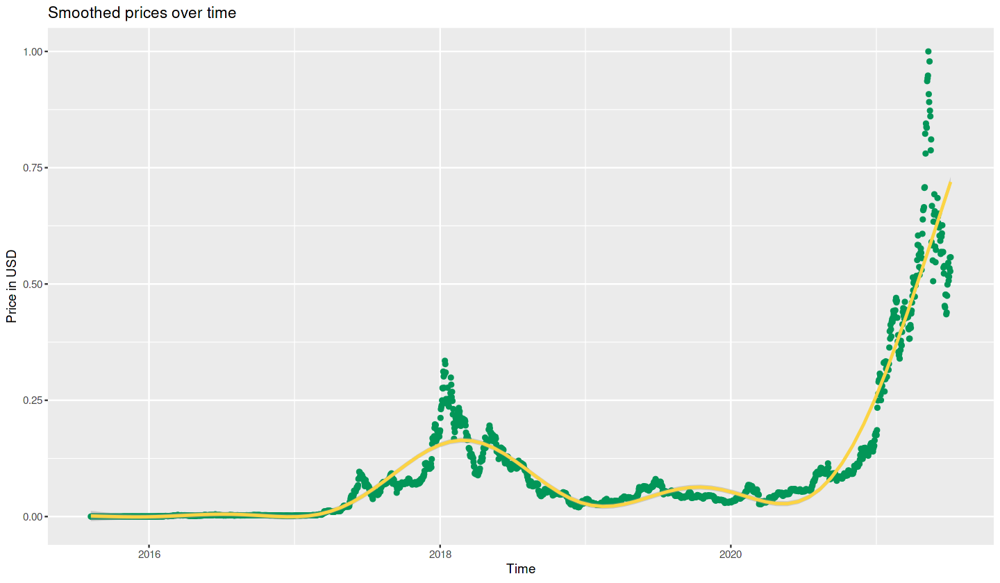

In [32]:
ggplot(data = ether_norm, aes(x=as.Date(Date),y=Close)) +
    geom_point(color= "#029658")+
    geom_smooth(aes(group= -1), method ='gam', formula =y ~ s(x), color = "#fcd444" ) +
    labs(title="Smoothed prices over time", y="Price in USD", x="Time")

From visual inspection ETH tends to have explosive growth and relatively high volatility. Let's examine trading volume against closing price:

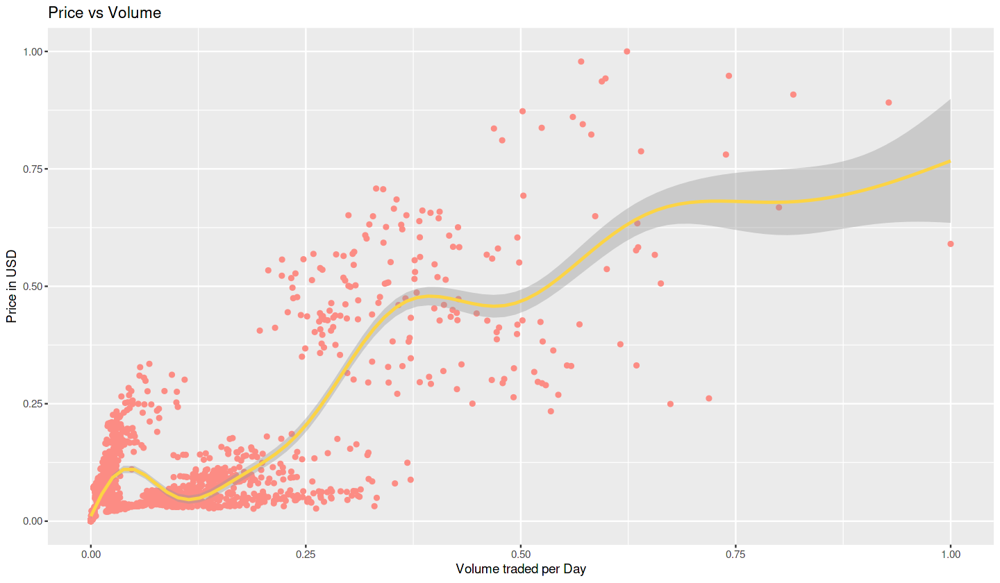

In [33]:
ggplot(data = ether_norm,aes(x=Volume,y=Close)) +
    geom_point(color="#fc8c84") +
    geom_smooth(aes(group= -1), method ='gam', formula =y ~ s(x), color = "#fcd444" ) +
    labs(title="Price vs Volume", y="Price in USD", x="Volume traded per Day") 

Ethereum has a relatively nice volume to price correlation. We can also observe that our regression begins to fail at the very high end: it works better where our data points are clustered tightly.

Let's take a look at how the volume is trending over time:

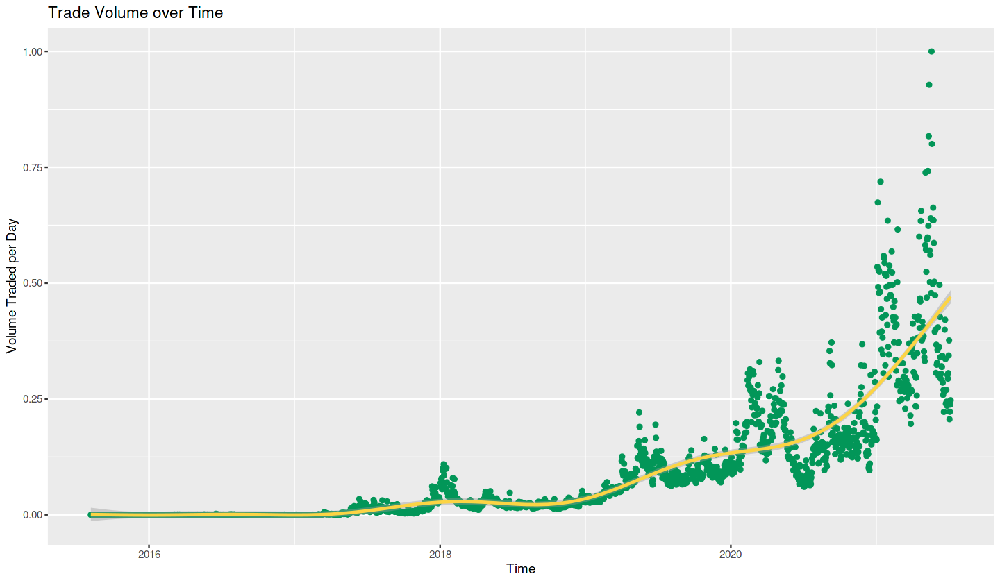

In [34]:
ggplot(data = ether_norm,aes(x=as.Date(Date),y=Volume)) +
    geom_point(color= "#029658") +
    geom_smooth(aes(group= -1), method ='gam', formula =y ~ s(x), color = "#fcd444" ) +
    labs(title="Trade Volume over Time", y="Volume Traded per Day", x="Time") 

We see that ETH is being traded fairly frequently, and is trending upward in general.

## ETH Market Capitalization vs. Market Prices

**ETH Market Capitalization vs. Market Opening Prices**

From the shown graph, we see a moderate variation between the points, this can be seen by how well or not the points follow the line of best fit.The cause islikely-due to after trading that occurs after the Closing price of the preceding day. Meaning, with these fluctations in the marketcap due to these after hours trading, the Opening price is more volatile the larger the marketing cap.

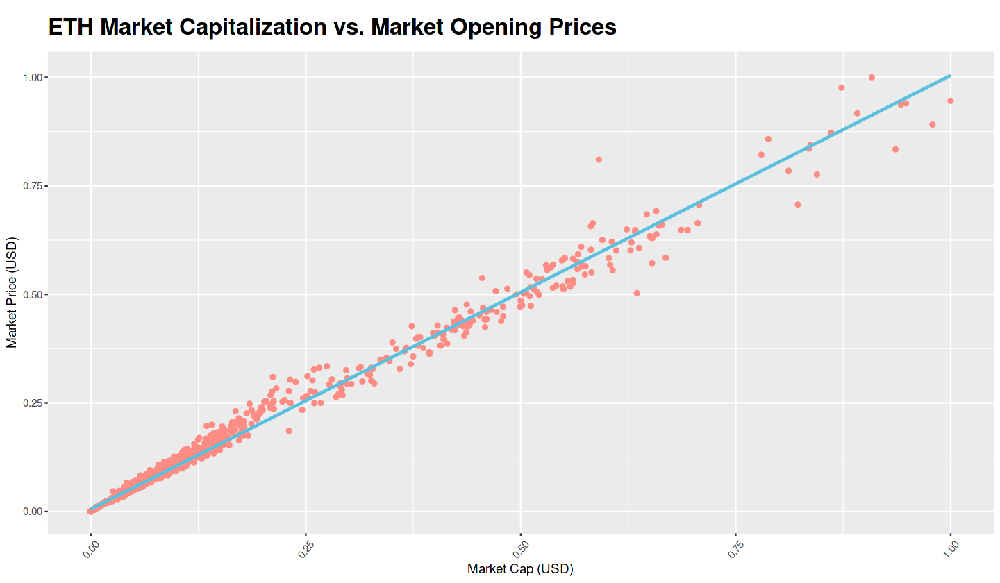

In [35]:
ggplot(ether_norm, aes(Marketcap, Open)) + 
  geom_point(color="#fc8c84") +
  ggtitle('ETH Market Capitalization vs. Market Opening Prices') +
  theme(plot.title = element_text(size=19.5, face="bold", 
    margin = margin(10, 0, 10, 0)))+
  labs(x="Market Cap (USD)", y="Market Price (USD)")+
  theme(axis.text.x=element_text(angle=50, vjust=0.5)) +
  stat_smooth(method = "lm",  formula = y ~ x, col = "#5bc0de")

**ETH Market Capitalization vs. Market Closing Prices**

From the shown graph, we can see very little variation in the point with a slight off shoot, slowly tapering inbetween 1e+11 and 2e+11. However, overall at closing we see that there is a small variation as the points follow a similar trend to the produced line. Thus from the graph we can see the closing price is less volatile and tends to stay consistant along the produced line. 

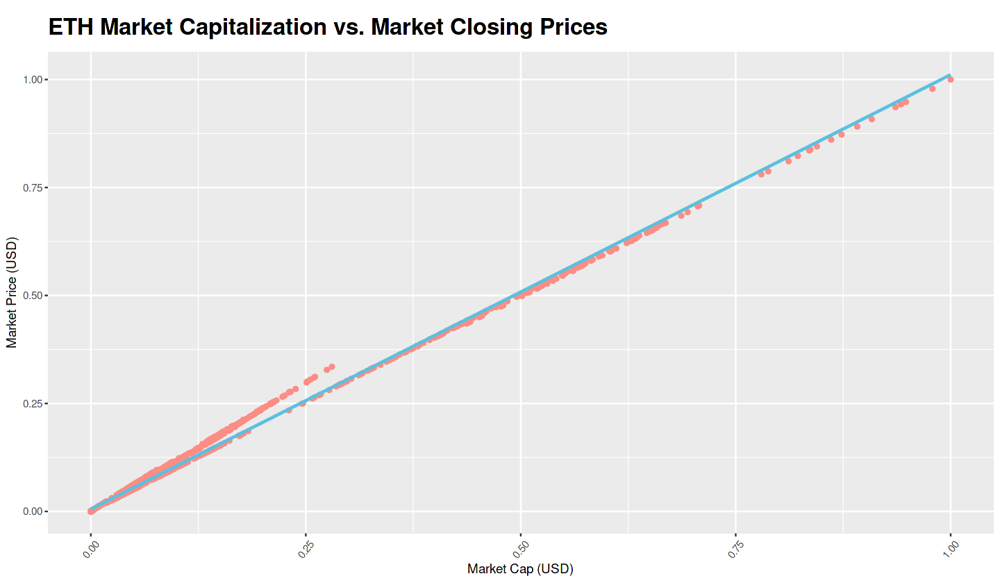

In [36]:
#market price vs market cap  -- write observations
ggplot(ether_norm, aes(Marketcap, Close)) + 
  geom_point(color="#fc8c84") +
  ggtitle('ETH Market Capitalization vs. Market Closing Prices') +
  theme(plot.title = element_text(size=19.5, face="bold", 
    margin = margin(10, 0, 10, 0)))+
  labs(x="Market Cap (USD)", y="Market Price (USD)")+
  theme(axis.text.x=element_text(angle=50, vjust=0.5)) +
  stat_smooth(method = "lm",  formula = y ~ x, col = "#5bc0de")

**Comparison**

Opening prices are more volatile then the closing price, they have larger variation likely closed by after changed during after-hour periods. However, both of these charts show a very similar line and upward trend. In fact, despite the variation in the Opening price, the line of best fit, very closely resembles the line from the more stable closing cost. 

# Stepwise regression

To identify the best explanatory variables to use in the forecasting model, we decided to use stepwise regression in order to better understand how each variable influences the model holistically

Forward selection, which starts with no predictors in the model, iteratively adds the most contributive predictors, and stops when the improvement is no longer statistically significant.

Backward selection (or backward elimination), which starts with all predictors in the model (full model), iteratively removes the least contributive predictors, and stops when you have a model where all predictors are statistically significant.

Stepwise selection (or sequential replacement), which is a combination of forward and backward selections. You start with no predictors, then sequentially add the most contributive predictors (like forward selection). After adding each new variable, remove any variables that no longer provide an improvement in the model fit (like backward selection).

The [MASS package], which chooses the best model by AICm has an option named direction, which can take the following values: 

i) “both” (for stepwise regression, both forward and backward selection); “backward” (for backward selection) and “forward” (for forward selection). It return the best found final model.

regsubsets() [leaps package], which has the tuning parameter nvmax specifying the maximal number of predictors to incorporate in the model. It returns multiple models with different size up to nvmax. Then the performance of the different models are compared for choosing the best one so that the best one is found. regsubsets() has the options, which can take the values “backward”, “forward” and “seqrep” (seqrep = sequential replacement, combination of forward and backward selections).

The train() function [caret package] provides an easy workflow to perform stepwise selections using the leaps and the MASS packages. It has an option named method, which can take the following values:F

Essentially: 

1. "leapBackward", to fit linear regression with backward selection
2. "leapForward", to fit linear regression with forward selection
3. "leapSeq", to fit linear regression with stepwise selection .

In [37]:
# Fit the full model 
full.model <- lm(Marketcap ~ Low + Open + Close + Volume + High ,data = num_val)
# Stepwise regression model
step.model <- stepAIC(full.model, direction = "both", trace = FALSE)

summary(step.model)


Call:
lm(formula = Marketcap ~ Low + Close + Volume + High, data = num_val)

Residuals:
      Min        1Q    Median        3Q       Max 
-0.036419 -0.003649  0.000821  0.005475  0.022434 

Coefficients:
              Estimate Std. Error t value Pr(>|t|)    
(Intercept) -0.0061288  0.0001901 -32.235  < 2e-16 ***
Low          0.1027709  0.0194830   5.275 1.46e-07 ***
Close        0.9665475  0.0272814  35.429  < 2e-16 ***
Volume       0.0530708  0.0019899  26.670  < 2e-16 ***
High        -0.1184387  0.0196351  -6.032 1.90e-09 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 0.007128 on 2155 degrees of freedom
Multiple R-squared:  0.9975,	Adjusted R-squared:  0.9975 
F-statistic: 2.17e+05 on 4 and 2155 DF,  p-value: < 2.2e-16


In [38]:
models <- regsubsets(Marketcap ~., data = num_val, nvmax = 5,
                     method = "seqrep")
summary(models)

Subset selection object
Call: regsubsets.formula(Marketcap ~ ., data = num_val, nvmax = 5, 
    method = "seqrep")
5 Variables  (and intercept)
       Forced in Forced out
High       FALSE      FALSE
Low        FALSE      FALSE
Open       FALSE      FALSE
Close      FALSE      FALSE
Volume     FALSE      FALSE
1 subsets of each size up to 5
Selection Algorithm: 'sequential replacement'
         High Low Open Close Volume
1  ( 1 ) " "  " " " "  "*"   " "   
2  ( 1 ) " "  " " " "  "*"   "*"   
3  ( 1 ) "*"  "*" "*"  " "   " "   
4  ( 1 ) "*"  "*" "*"  "*"   " "   
5  ( 1 ) "*"  "*" "*"  "*"   "*"   

In [39]:
# Set up repeated k-fold cross-validation

train.control <- trainControl(method = "cv", number = 10)
frame =data.frame(nvmax = 1:6)

In [40]:
step.model <- caret::train(Marketcap ~., 
                    data = num_val,
                    method = 'leapForward', 
                    tuneGrid = frame,
                    trControl = train.control
                    )
# caret was masked by something; use caret::
leapFor <-step.model$results


In [41]:
# Using Forward Selection 
step.model$bestTune
summary(step.model$finalModel)

,nvmax
,<int>
4,4


Subset selection object
5 Variables  (and intercept)
       Forced in Forced out
High       FALSE      FALSE
Low        FALSE      FALSE
Open       FALSE      FALSE
Close      FALSE      FALSE
Volume     FALSE      FALSE
1 subsets of each size up to 4
Selection Algorithm: forward
         High Low Open Close Volume
1  ( 1 ) " "  " " " "  "*"   " "   
2  ( 1 ) " "  " " " "  "*"   "*"   
3  ( 1 ) "*"  " " " "  "*"   "*"   
4  ( 1 ) "*"  "*" " "  "*"   "*"   

In [42]:
step.model <- caret::train(Marketcap ~., 
                    data = num_val,
                    method = 'leapSeq', 
                    tuneGrid = frame,
                    trControl = train.control
                    )
# caret was masked by something; use caret::
leapSeq <-step.model$results


In [43]:
# Using Stepwise Selection 
step.model$bestTune
summary(step.model$finalModel)

,nvmax
,<int>
5,5


Subset selection object
5 Variables  (and intercept)
       Forced in Forced out
High       FALSE      FALSE
Low        FALSE      FALSE
Open       FALSE      FALSE
Close      FALSE      FALSE
Volume     FALSE      FALSE
1 subsets of each size up to 5
Selection Algorithm: 'sequential replacement'
         High Low Open Close Volume
1  ( 1 ) " "  " " " "  "*"   " "   
2  ( 1 ) " "  " " " "  "*"   "*"   
3  ( 1 ) "*"  "*" "*"  " "   " "   
4  ( 1 ) "*"  "*" "*"  "*"   " "   
5  ( 1 ) "*"  "*" "*"  "*"   "*"   

In [44]:
step.model <- caret::train(Marketcap ~., 
                    data = num_val,
                    method = 'leapBackward', 
                    tuneGrid = frame,
                    trControl = train.control
                    )
# caret was masked by something; use caret::
leapBack <-step.model$results

In [45]:
# Using backward selection 

step.model$bestTune

summary(step.model$finalModel)

,nvmax
,<int>
4,4


Subset selection object
5 Variables  (and intercept)
       Forced in Forced out
High       FALSE      FALSE
Low        FALSE      FALSE
Open       FALSE      FALSE
Close      FALSE      FALSE
Volume     FALSE      FALSE
1 subsets of each size up to 4
Selection Algorithm: backward
         High Low Open Close Volume
1  ( 1 ) " "  " " " "  "*"   " "   
2  ( 1 ) " "  " " " "  "*"   "*"   
3  ( 1 ) "*"  " " " "  "*"   "*"   
4  ( 1 ) "*"  "*" " "  "*"   "*"   

nvmax: the number of variable in the model. From the above all 3 of the backward, forward, and sequential state the best model is produced using High, Low, Close, and Volume.  nvmax = 4 but nvmax = 5 at the step wise selection

RMSE and MAE are two different metrics measuring the prediction error of each model. The lower the RMSE and MAE, the better the model.

R-squared indicates the correlation between the observed outcome values and the values predicted by the model. The higher the R squared, the better the model.

In [46]:
leapFor #nvmax 4 
leapBack # nvmax 4
leapSeq # nvmax 5

,nvmax,RMSE,Rsquared,MAE,RMSESD,RsquaredSD,MAESD
,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,1,0.008196780,0.9966077,0.005649689,0.0006001723,0.0008285382,0.0002720575
2,2,0.007212578,0.9974057,0.005144337,0.0006077633,0.0005715904,0.0003106342
3,3,0.007232138,0.9974018,0.005179529,0.0005877298,0.0005660667,0.0002944208
4,4,0.007154151,0.9974694,0.005197723,0.0005720455,0.0004916040,0.0003042563
5,5,0.007177908,0.9974548,0.005208096,0.0005766738,0.0004854637,0.0003048699
6,6,0.007177908,0.9974548,0.005208096,0.0005766738,0.0004854637,0.0003048699


,nvmax,RMSE,Rsquared,MAE,RMSESD,RsquaredSD,MAESD
,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,1,0.008192025,0.9966921,0.005650099,0.0006742310,0.0006599948,0.0003524707
2,2,0.007220738,0.9974644,0.005144442,0.0005039139,0.0004317292,0.0003042170
3,3,0.007213614,0.9974633,0.005171544,0.0004978162,0.0004182331,0.0003086493
4,4,0.007157641,0.9974927,0.005195736,0.0004759073,0.0004051035,0.0002874521
5,5,0.007176091,0.9974799,0.005202332,0.0004742195,0.0004078581,0.0002846436
6,6,0.007176091,0.9974799,0.005202332,0.0004742195,0.0004078581,0.0002846436


,nvmax,RMSE,Rsquared,MAE,RMSESD,RsquaredSD,MAESD
,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,1,0.008210121,0.9966090,0.005650014,0.0003475668,0.0007895728,0.0002620640
2,2,0.007227289,0.9973930,0.005138805,0.0002083413,0.0005445868,0.0002021328
3,3,0.008645681,0.9962253,0.005827346,0.0008249305,0.0010812559,0.0004353989
4,4,0.008242925,0.9965802,0.005663267,0.0003338662,0.0007993932,0.0002581603
5,5,0.007179422,0.9974209,0.005198382,0.0001992059,0.0005414083,0.0002237171
6,6,0.007179422,0.9974209,0.005198382,0.0001992059,0.0005414083,0.0002237171


Based on our results, we decided to choose attribute High to forecast.

# Forecasting Ethereum High Prices

In [47]:
# Etting the plot theme
my_theme = theme(panel.grid = element_line(color = '#e6e6e6'),
                 panel.background = element_rect(fill = 'white'),
                 plot.title = element_text(hjust = .5, size = 28, colour = '#029658'),
                 text = element_text(family = 'Georgia'),
                 axis.text = element_text(size = 10),
                 axis.title = element_text(size = 15, family = 'Georgia', face = 'bold'),
                 axis.line = element_line(colour = '#737373', size = 1),
                 strip.background = element_rect(colour = "black", fill = "white"),
                 strip.text = element_text(face = 'bold'))  

We are going to split the dataframe in 2:
* eth_df1 will be our main dataset
* eth_df2 are the last 100 days of the dataser

The first dataset contains the data up until the last 100 days, while the second dataset contains only the last 100 days which will be looked at to compare the final model only at the very end.

In [48]:
eth_df1 <- ether_norm[ether_norm$Date >= "2015-08-08" & ether_norm$Date <= "2021-03-21", ]
eth_df2 <- ether_norm[ether_norm$Date >= "2021-03-2" & ether_norm$Date <= "2021-07-07", ]

In [49]:
# Convert data frame to a tibble 
eth_df = eth_df1 %>% tk_tbl(ether_norm)

Warning message in if (preserve_index == TRUE) {:
“the condition has length > 1 and only the first element will be used”
Warning message in tk_tbl.data.frame(., ether_norm):
“Warning: No index to preserve. Object otherwise converted to tibble successfully.”


We start by looking at our time series:

In [50]:
ggplotly(ggplot(eth_df, aes(Date, High)) + geom_line(col = '#1abc9c') + 
  labs(title = 'Ethereum', x = '') +
      scale_y_continuous(breaks = c(0, 0.1, 0.2, 0.3, 0.4), 
                     labels = c('$0', '$1000', '$2000', '$3000', '$4000')) + my_theme)

HTML widgets cannot be represented in plain text (need html)

We can see that the first part of the data (up to march 2017) shows nearly no variation in price while the second part takes a completely different look. This is significant because, when we try to fit a model to this data, any external influences that could have caused the price fluctuation to look the way it does in the later part were not there before 2017.For this reason, it is probably safe to say to only look at data after 2017 because whatever was happening to Ethereum before then is not happening anymore. 
The following plot shows the time series we will be studying.

In [51]:
ggplotly(eth_df %>%
           filter(Date > as.Date('2017-03-01')) %>% ggplot(aes(Date, High)) + geom_line(col = '#1abc9c') + 
  labs(title = 'Ethereum', x = '') +
  scale_y_continuous(breaks = c(0, 0.1, 0.2, 0.3, 0.4), 
                     labels = c('$0', '$1000', '$2000', '$3000', '$4000')) + my_theme)

HTML widgets cannot be represented in plain text (need html)

# Initial Analysis

The first plot below shows the relationship between Ethereum pricing and lagged versions of itself. As you can see, for at least the first few lags, all of the data is highly correlated with itself. This graph is useful, but we won't be able to draw any conclusions until we examine the autocorrelation (ACF) and partial autocorrelation (PACF) plots.

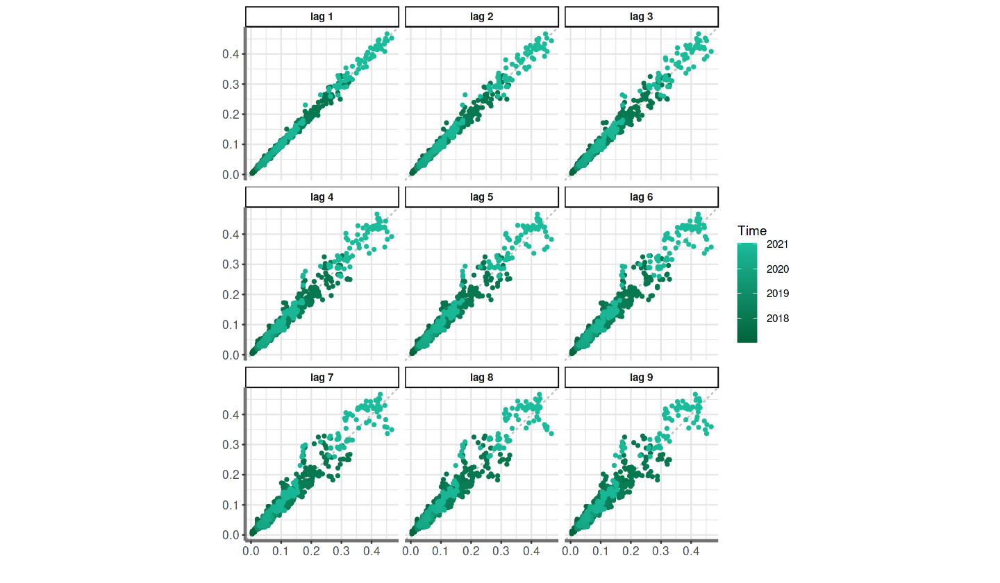

In [52]:
# The time series
eth_ts = eth_df %>%
  filter(Date > as.Date('2017-03-01')) %>%
  arrange(Date) %>%
  select(High) %>%
  as.matrix() %>%
  ts()

gglagplot(eth_ts, do.lines = F) + my_theme +
         scale_color_continuous(low = "#01633a", high = "#1abc9c", breaks = c(1, 366, 731, 1096, 1461), labels = c('2017', '2018', '2019', '2020', '2021'))  
  

**ACF and PACF**

The ACF and PACF suggest this data is taking a Random Walk, meaning that the future steps or directions cannot be predicted on the basis of past history. So a single difference should be applied, and the two plots should be reviewed again. Differencing can help stabilise the mean of a time series by removing changes in the level of a time series, and therefore eliminating (or reducing) trend and seasonality.

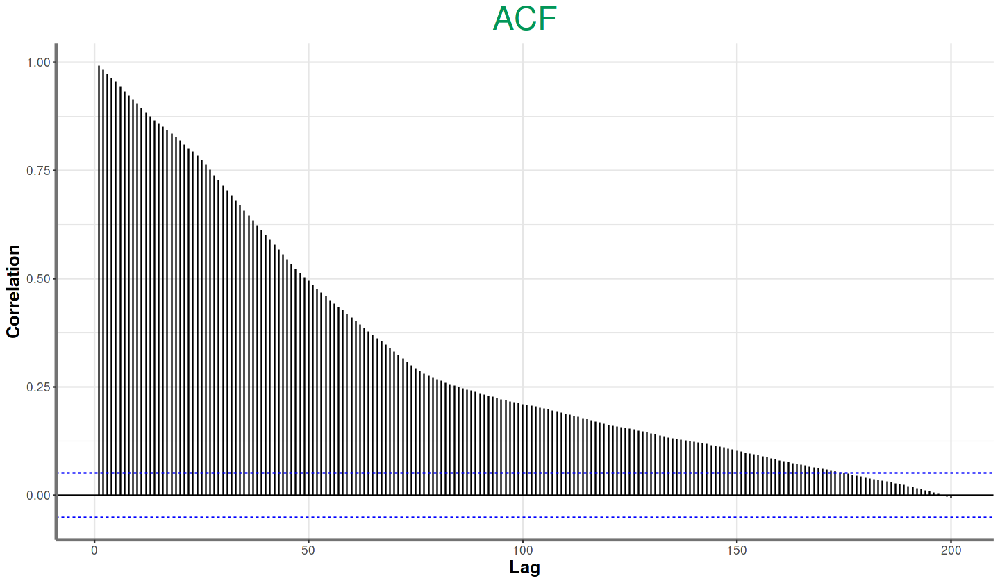

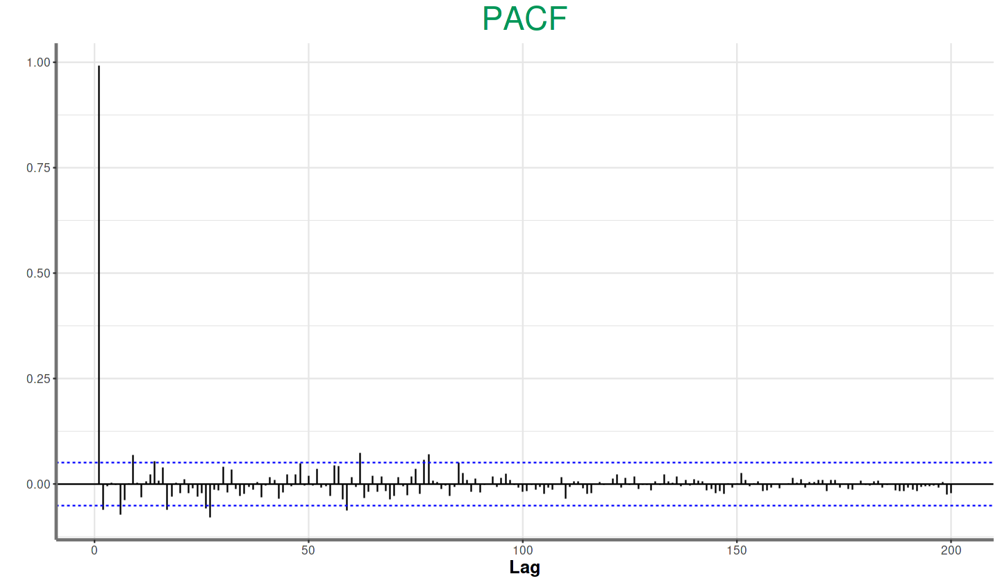

In [53]:
ggAcf(eth_ts, lag.max = 200) + my_theme + labs(title = 'ACF' , y = 'Correlation')

ggPacf(eth_ts, lag.max = 200) + my_theme + labs(title = 'PACF', y = '')

Our data looks a little like noise after only differencing it once. We take a closer look at the data once it has been differenced for the first time.

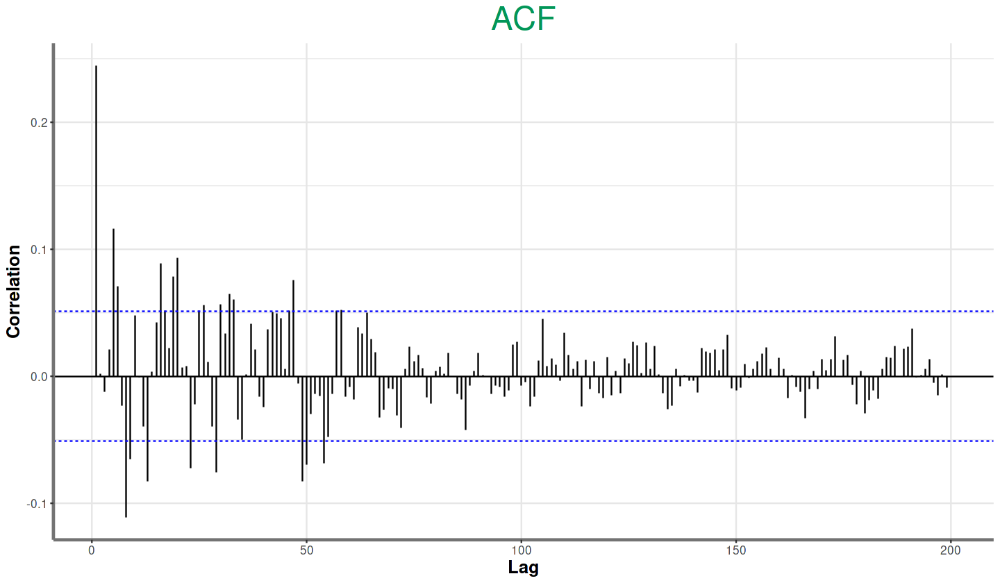

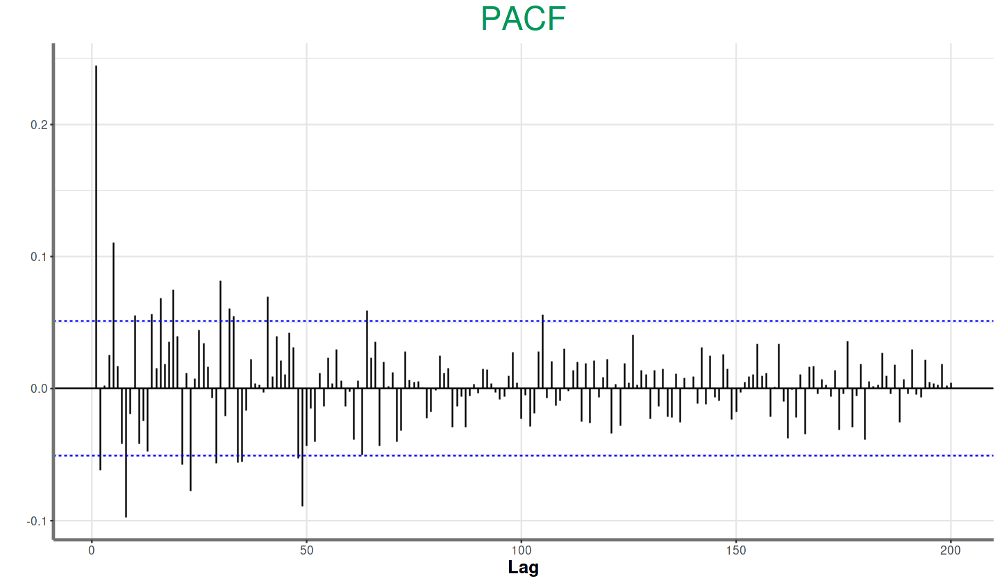

In [54]:
ggAcf(diff(eth_ts), lag.max = 200) + my_theme + labs(title = 'ACF' , y = 'Correlation') 

ggPacf(diff(eth_ts), lag.max = 200) + my_theme + labs(title = 'PACF', y = '')

Looking at the data after it has been differenced once reveals that it is not stationary, as the variance is far from constant. This explains why the ACF and PACF did not generate white noise at first. To obtain a constant variance, the data must undergo a transformation.

## The difference

In [55]:
cut_eth_df = eth_df %>%
  filter(Date > as.Date('2017-03-01'))

ggplotly(cut_eth_df[-1,] %>%
  mutate(High = diff(cut_eth_df$High)) %>%
  ggplot(aes(Date, High)) + geom_line(col = '#1abc9c') + my_theme + 
  labs(x = '', title = 'Ethereum Differenced By One', y = 'Difference'))

HTML widgets cannot be represented in plain text (need html)

# Transformation

The Box-Cox transformation is a power transformation that corrects asymmetry of a variable, different variances or non linearity between variables, and makes data set significantly normal distributed with constant mean and variance. In consequence, it is very useful to transform a variable and hence to obtain a new variable that follows a normal distribution.

The basic idea behind this method is to find some value for λ such that the transformed data is as close to normally distributed as possible, using the following formula. The “optimal value” is the one which results in the best approximation of a normal distribution curve.

* y(λ) = ((y^λ) – 1) / λ if λ ≠ 0
* y(λ) = log(y) if λ = 0

In order to find the value of y, we first have to find the value of λ. Finding the value for λ can be done using the function BoxCox.lambda(). When used on our data we get the following value for λ:

In [56]:
BoxCox.lambda(eth_ts)

[1] 0.1315779

### **Before transformation**

In [57]:
ggplotly(eth_df %>%
           filter(Date >= as.Date('2017-03-01')) %>% ggplot(aes(Date, High)) + geom_line(col = '#1abc9c') + 
  labs(title = 'Ethereum', x = '') +
  scale_y_continuous(breaks = c(0, 0.1, 0.2, 0.3, 0.4), 
                     labels = c('$0', '$1000', '$2000', '$3000', '$4000')) + my_theme)

HTML widgets cannot be represented in plain text (need html)

### **After transformation**

In [58]:
ggplotly(cut_eth_df %>%
           mutate(High = BoxCox(cut_eth_df$High, lambda = BoxCox.lambda(cut_eth_df$High))) %>%
           ggplot(aes(Date, High)) + geom_line(col = '#1abc9c') + 
  labs(title = 'Ethereum', x = '', y = 'Price (Transformed)') + my_theme)

HTML widgets cannot be represented in plain text (need html)

# Model fitting

Now that our data has been transformed, we can compare the differenced data to see how much of the variance has changed. We can observe how the transformation helped to spread out the data's volatility.

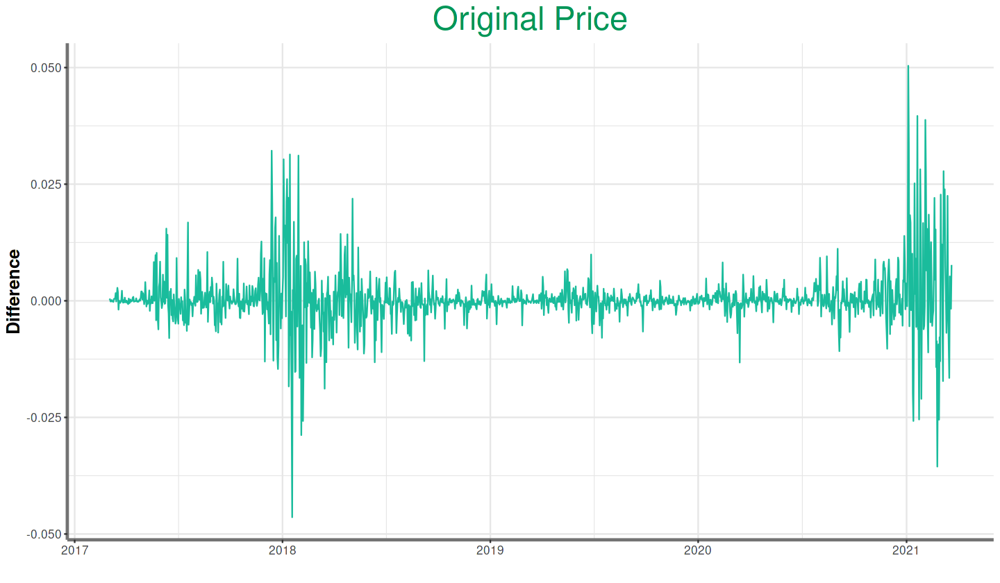

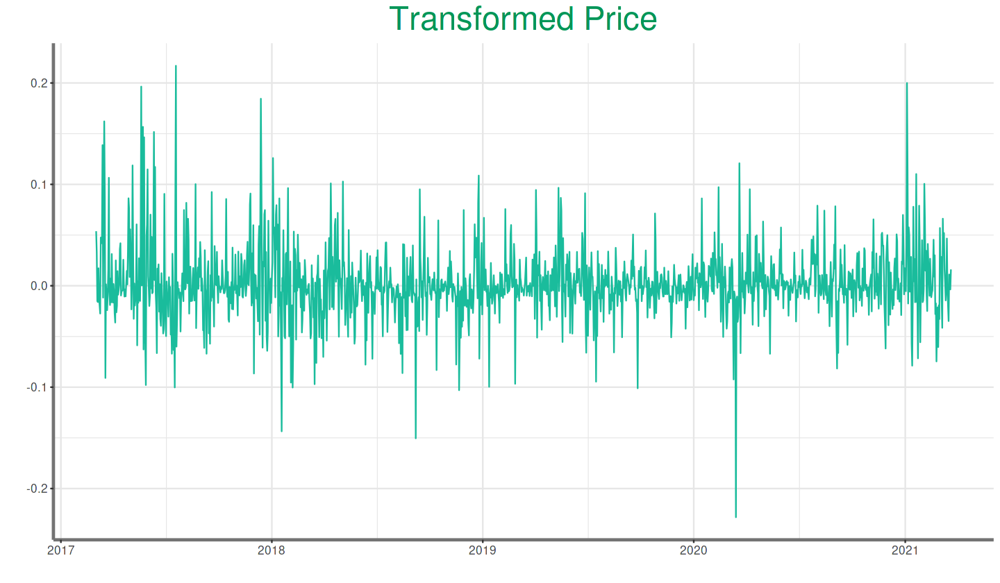

In [59]:
## Original Price
cut_eth_df[-1,] %>%
  mutate(Price = diff(cut_eth_df$High)) %>%
  ggplot(aes(Date, Price)) + geom_line(col = '#1abc9c') + my_theme + 
  labs(x = '', title = 'Original Price', y = 'Difference')

## Transformed Price
cut_eth_df[-1,] %>%
  mutate(Price = diff(BoxCox(cut_eth_df$High, lambda = BoxCox.lambda(cut_eth_df$High)))) %>%
  ggplot(aes(Date, Price)) + geom_line(col = '#1abc9c') + my_theme + 
  labs(x = '', title = 'Transformed Price', y = '')

To get a closer look, we should once again look at the ACF and PACF of our newly transformed data after it has been differenced once.

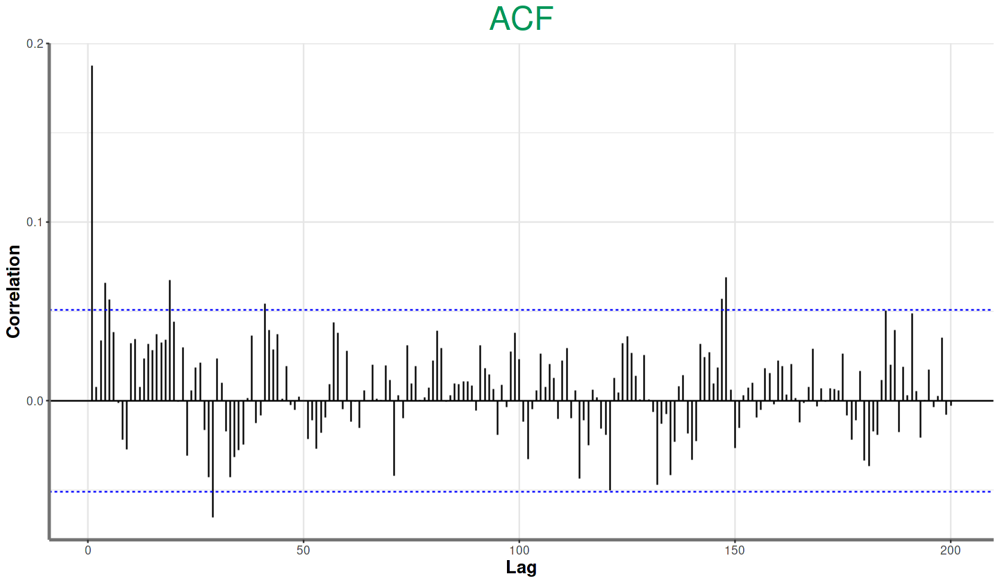

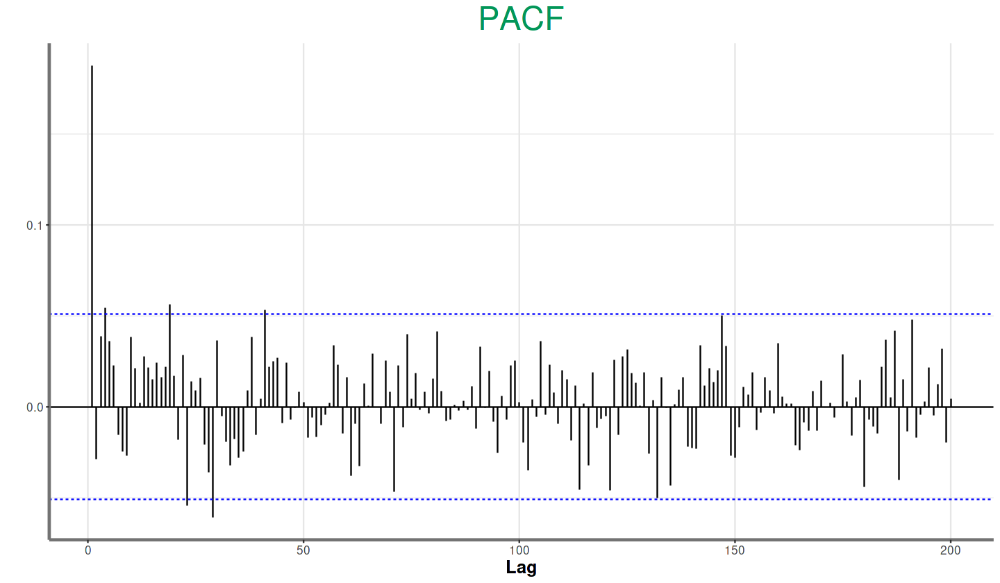

In [60]:
eth_ts_tran = BoxCox(eth_ts, lambda = BoxCox.lambda(eth_ts))

ggAcf(diff(eth_ts_tran), lag.max = 200) + my_theme + labs(title = 'ACF' , y = 'Correlation') 

ggPacf(diff(eth_ts_tran), lag.max = 200) + my_theme + labs(title = 'PACF', y = '')

The auto.arima() function, when applied to data, can tell us what ARIMA model is best suited by minimizing AIC (Akaike’s Information Criteria) and BIC (Bayesian Information Criteria) values, both widely used in model selection criteria. When this function is applied to our transformed data, here is the result:

In [61]:
auto.arima(eth_ts_tran)

Series: eth_ts_tran 
ARIMA(2,1,2) 

Coefficients:
         ar1     ar2      ma1      ma2
      0.9049  0.0760  -0.7128  -0.2453
s.e.  0.0979  0.1206   0.0924   0.1220

sigma^2 estimated as 0.001166:  log likelihood=2899.96
AIC=-5789.91   AICc=-5789.87   BIC=-5763.42

Apparently, an ARIMA(2, 1, 2) model is best at the moment. When we use this model to fit our data, checkresiduals() is another useful function that will show us whether or not it’s a good fit. Let’s fit an ARIMA(2, 1, 2) model and see how it looks.


	Ljung-Box test

data:  Residuals from ARIMA(2,1,2)
Q* = 9.5995, df = 6, p-value = 0.1426

Model df: 4.   Total lags used: 10



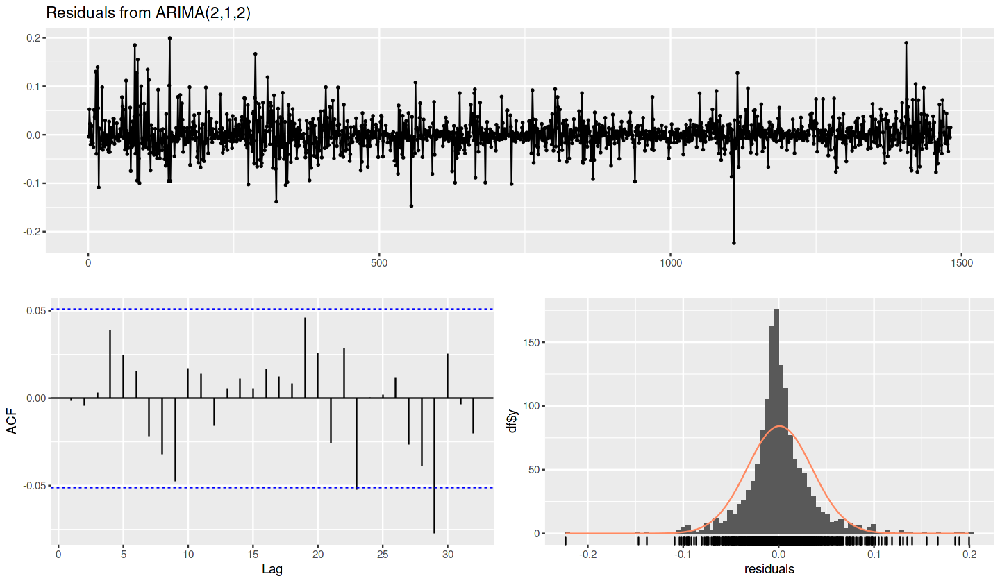

In [62]:
checkresiduals(auto.arima(eth_ts_tran))

This function shows us a number of valuable things. At the top, we get a plot of the residuals. This allows to visually inspect the outcome to see if it at least resembles something similar to white noise. Here we can see there is a constant mean, and possibly a constant variance.

Under that and to the left we see the ACF ploted out for the residuals.

To the right we are shown a histogram of the residuals. Here our residuals look close to a normal distribution, which is the desired result, but there are still a good number of outliers.

Finally, a Ljung-Box test is performed and the results appear at the top. The most important result for this test is the p-value. A significant p-value in this test rejects the null hypothesis that the time series isn’t autocorrelated. The p-value obtained for this model is about 14%. The typical threshold for a bad model is a value of 5% or lower. Our p-value is well above 5%, so there is no need to fix it.

# Conclusion

A look at the residuals above provide strong evidence that although the entire data may show signs of a complex trend, Ethereum is intrinsically taking a Random Walk with a drift. Let’s take another look at this model:


In [63]:
summary(Arima(eth_ts_tran, order = c(2,1,2), include.drift = T))

Series: eth_ts_tran 
ARIMA(2,1,2) with drift 

Coefficients:
         ar1     ar2      ma1      ma2   drift
      0.8144  0.1193  -0.6238  -0.2672  0.0022
s.e.  0.1671  0.1366   0.1635   0.1215  0.0015

sigma^2 estimated as 0.001165:  log likelihood=2901.37
AIC=-5790.74   AICc=-5790.68   BIC=-5758.94

Training set error measures:
                        ME       RMSE        MAE          MPE     MAPE    MASE
Training set -5.792864e-05 0.03405833 0.02259544 -0.007248553 1.132525 1.00475
                     ACF1
Training set -0.001321784

Our drift is small, but positive. This suggests if a linear trend is present, it is very small and upward. We could present the model like:

**(Price Tomorrow) = (Price Today) + 0.0022 + (Random Noise)**

It is important to remember that this formula only works after the data has been transformed. In the Forecasting section, we will create a function that does all this automatically. To use this simple model to create better predictions, we can learn a few things about the “Random Noise” that plays a part.

In [64]:
err = residuals(Arima(eth_ts_tran, order = c(2,1,2), include.drift = T))
cat('Standard Deviation = ', sd(err))

Standard Deviation =  0.03406978

In [65]:
cat('Mean =', mean(err))

Mean = -5.792864e-05

The average of the noise should be zero if it is white noise, which is what we were going for, but the standard deviation is deceivingly small. This is because this value doesn’t mean anything unless it has been re-transformed. We'll create an inverse BoxCox function. Then we can see what the standard deviation of the noise is in units of dollars.

In [66]:
invers_BoxCox = function(ts_data, lambda){
  original_ts = (ts_data * lambda + 1) ** (1/lambda)
  return(original_ts)
}

invers_BoxCox(sd(err), BoxCox.lambda(eth_ts))

[1] 1.034578

This means the “Random Noise” has a standard deviation of about $1

# **FORECASTING**

Now we are going to look at the second dataset, the last 100 days of our data, which is the period we're trying to predict.

In [67]:
eth_df2 = eth_df2 %>%
  filter(Date > as.Date('2017-03-01')) %>%
  arrange(Date)

ggplotly(ggplot(eth_df2, aes(Date, High)) + geom_line(col = '#1abc9c') + 
  labs(title = 'Ethereum', x = '') +
  scale_y_continuous(breaks = c(0, 0.1, 0.2, 0.3, 0.4), 
                     labels = c('$0', '$1000', '$2000', '$3000', '$4000')) + my_theme)

HTML widgets cannot be represented in plain text (need html)

Below we are creating the function to make predictions where **h** is the number of days we want to predict.


In [68]:
# h is the the length we want the prediction to be in units of days

fit_model = function(ethereum_data, h){
  ethereum_df = ethereum_data %>%
    filter(Date >= as.Date('2017-01-01')) %>%
    arrange(Date)
    
  time_series = ethereum_df %>%
    select(High) %>%
    ts()

  predictions = time_series %>%
    BoxCox(lambda = BoxCox.lambda(time_series)) %>% 
    auto.arima() %>%
    forecast(h)
  
  forecast_df = cbind(data.frame(predictions[4]), 
             data.frame(predictions[5]), 
             data.frame(predictions[6]))
  
  the_forecast = invers_BoxCox(forecast_df, lambda = BoxCox.lambda(time_series))
  
  the_forecast = the_forecast %>%
    mutate(Date = tail(ethereum_df$Date, h) + h) %>%
    as_tibble()
  
  return(the_forecast)
}

Below we plot the results of our model:
* The green plot is our training dataset
* The black plot is our test dataset
* the red line and the orange areas are the forecasting results from our model

In [69]:
ggplotly(fit_model(ether_norm, 100) %>%
  ggplot(aes(x = Date, y = mean)) + geom_line(col = 'red') +
  geom_ribbon(aes(ymin = lower.80., ymax = upper.80.), alpha = .3, fill = '#ffc04c') +
  geom_ribbon(aes(ymin = lower.95., ymax = upper.95.), alpha = .3, fill = '#ffe4b2') +
  geom_line(data = eth_df2, aes(Date, High)) +
  geom_line(data = filter(eth_df, Date >= as.Date('2017-03-01')), aes(Date, High), col = '#1abc9c') + my_theme +
    labs(title = 'Ethereum Prediction of 100 Days', y = 'Price', x = '') +
    scale_y_continuous(breaks = c(0, 0.5, 1, 1.5), 
                     labels = c('$0', '$2500', '$4000', '$5000')) + my_theme)

HTML widgets cannot be represented in plain text (need html)

Our model predicts an upward trend in Ethereum High prices.

# Forecasting with Prophet

For comparison, we also tried to make a prediction using Prophet: 
Prophet is a procedure for forecasting time series data based on an additive model where non-linear trends are fit with yearly, weekly, and daily seasonality, plus holiday effects. Prophet is robust to missing data and shifts in the trend, and typically handles outliers well.

We use the prophet() command to create a dynamic forecasting model. We will store this model as an object named Model1. After which, we will add 186 periods (6 months) to the sample using the make_future_dataframe() command. This will be filled up with future forecasted values in the next step.

In [70]:
ds <- ether_norm$Date
y <- ether_norm$Close
df <- data.frame(ds, y)
Model1 <- prophet(df,daily.seasonality=FALSE )
Future1 <- make_future_dataframe(Model1, periods = 100)

We will predict the forecasted values using predict() and create an object Forecast1 to store these. The tail command will list the last few forecasted observations which contain the details on the date (ds), the forecasted value (that), and the confidence interval of the estimate.

In [71]:
Forecast1 <- predict(Model1, Future1)
tail(Forecast1[c('ds','yhat','yhat_lower','yhat_upper')])

,ds,yhat,yhat_lower,yhat_upper
,<dttm>,<dbl>,<dbl>,<dbl>
2255,2021-10-09 23:59:59,0.6847407,0.6244011,0.7467952
2256,2021-10-10 23:59:59,0.6860617,0.6240007,0.7514364
2257,2021-10-11 23:59:59,0.6875404,0.6261308,0.7496059
2258,2021-10-12 23:59:59,0.6890384,0.6253574,0.7540272
2259,2021-10-13 23:59:59,0.6895560,0.6309429,0.7542230
2260,2021-10-14 23:59:59,0.6902396,0.6282911,0.7530634


We use the dyplot.prophet() command to graph out the forecast which yields us the figure at the start of the article. We can also adjust the span by using the slider in the bottom of the plot area.

In [72]:
#plot forecast
dyplot.prophet(Model1, Forecast1)

Warning message:
“`select_()` was deprecated in dplyr 0.7.0.
Please use `select()` instead.
This warning is displayed once every 8 hours.
Call `lifecycle::last_lifecycle_warnings()` to see where this warning was generated.”


HTML widgets cannot be represented in plain text (need html)

As we can see, there seems to be an upward trend to ETH prices for the next months. We may view the specific values by hovering around the area. We can also see certain seasonality or day of the week effects by using the prophet_plot_components() command.

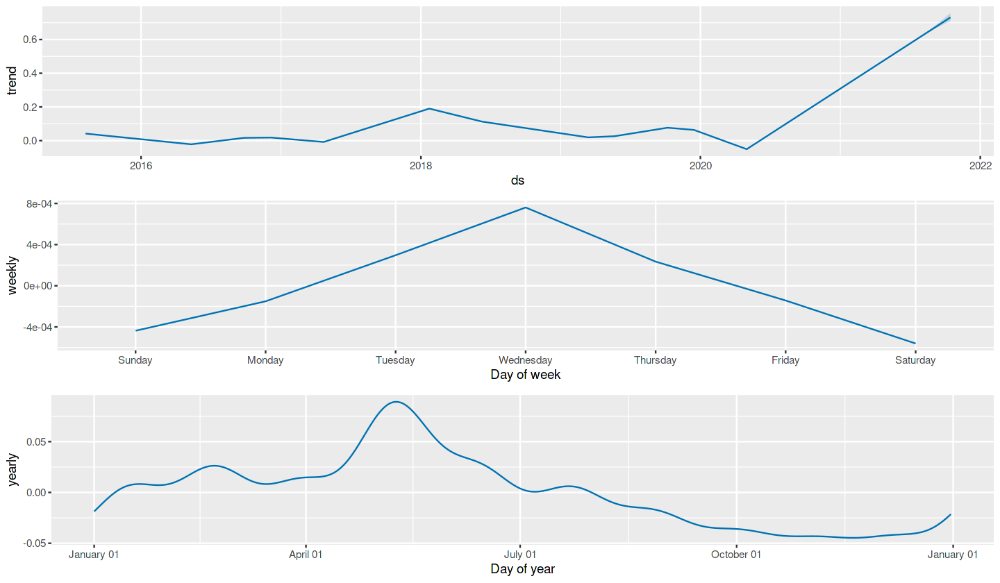

In [73]:
prophet_plot_components(Model1, Forecast1)

Like our model, we can see that Prophet also predicts an upward trend in Ethereum High prices, on the same 100 days that was used for our model. With this model we can also predict future days outside our dataset.